In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

In [ ]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Helper function: visualize images
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

In [ ]:
def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

Generator

In [ ]:
class Generator(nn.Module):
  def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
    super(Generator, self).__init__()
    self.z_dim = z_dim

    self.gen = nn.Sequential(
        self.make_gen_block(z_dim, hidden_dim * 4),
        self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
        self.make_gen_block(hidden_dim * 2, hidden_dim),
        self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
    )

  def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
    if not final_layer:
        return nn.Sequential(
            nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
            nn.BatchNorm2d(output_channels),
            nn.ReLU(inplace=True),
        )
    else:
        return nn.Sequential(
            nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
            nn.Tanh(),
        )

  def forward(self, noise):
    x = noise.view(len(noise), self.z_dim, 1, 1)
    return self.gen(x)

In [ ]:
def get_noise(n_samples, z_dim, device='cpu'):
  return torch.randn(n_samples, z_dim, device=device)

Critic

In [ ]:
class Critic(nn.Module):
  def __init__(self, im_chan=1, hidden_dim=64):
    super(Critic, self).__init__()
    self.crit = nn.Sequential(
        self.make_crit_block(im_chan, hidden_dim),
        self.make_crit_block(hidden_dim, hidden_dim * 2),
        self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
    )

  def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
    if not final_layer:
      return nn.Sequential(
          nn.Conv2d(input_channels, output_channels, kernel_size, stride),
          nn.BatchNorm2d(output_channels),
          nn.LeakyReLU(0.2, inplace=True),
      )
    else:
      return nn.Sequential(
          nn.Conv2d(input_channels, output_channels, kernel_size, stride),
      )

  def forward(self, image):
    crit_pred = self.crit(image)
    return crit_pred.view(len(crit_pred), -1)

Training

In [ ]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
  transforms.ToTensor(),
  transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
  MNIST('.', download=False, transform=transform),
  batch_size=batch_size,
  shuffle=True)

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))

crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
  if isinstance(m, nn.BatchNorm2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

Gradient penalty

In [ ]:
def get_gradient(crit, real, fake, epsilon):
  mixed_images = real * epsilon + fake * (1 - epsilon)
  mixed_scores = crit(mixed_images)
  
  gradient = torch.autograd.grad(
      inputs=mixed_images,
      outputs=mixed_scores,
      grad_outputs=torch.ones_like(mixed_scores), 
      create_graph=True,
      retain_graph=True,
  )[0]
  return gradient

In [ ]:
def gradient_penalty(gradient):
  gradient = gradient.view(len(gradient), -1)
  gradient_norm = gradient.norm(2, dim=1)

  penalty = torch.mean((gradient_norm - 1)**2)
  return penalty

Losses

In [ ]:
def get_gen_loss(crit_fake_pred):
  gen_loss = -1. * torch.mean(crit_fake_pred)
  return gen_loss

In [ ]:
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
  crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
  return crit_loss

Step 50: Generator loss: -0.08227599824778736, critic loss: 1.6470103410482397


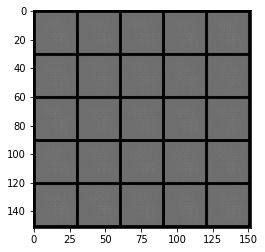

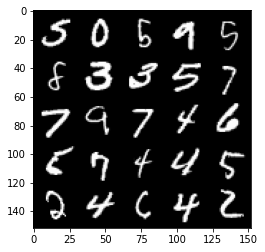

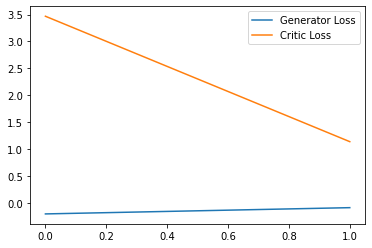

Step 100: Generator loss: 2.3316442753374576, critic loss: -4.186433098316193


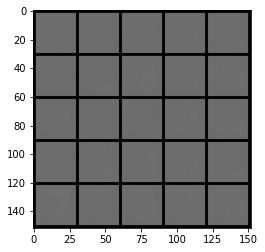

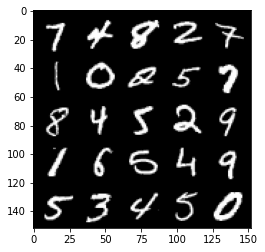

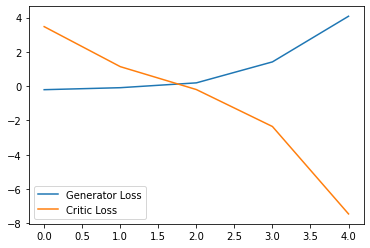

Step 150: Generator loss: 2.154216624498367, critic loss: -12.923877628326418


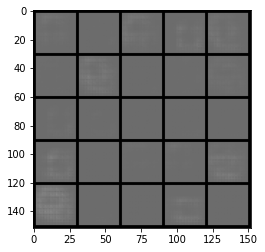

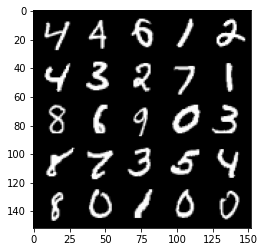

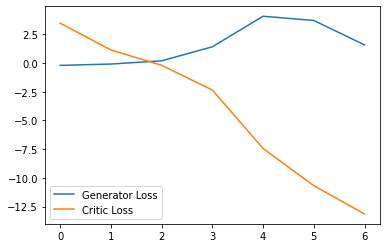

Step 200: Generator loss: 0.4541795690357685, critic loss: -30.398403419494624


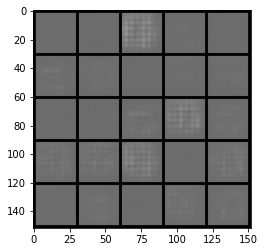

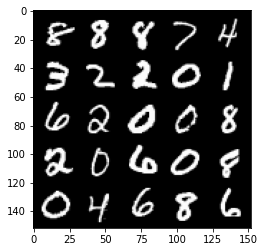

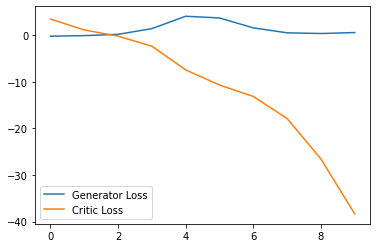

Step 250: Generator loss: 1.4401118940114974, critic loss: -65.32589680480957


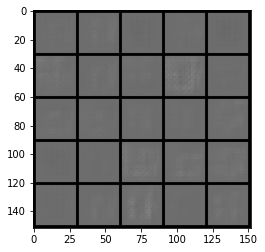

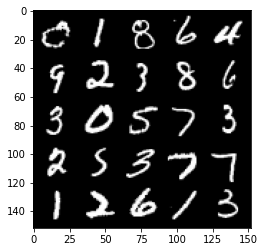

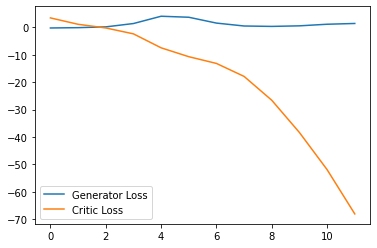

Step 300: Generator loss: 5.056944332122803, critic loss: -114.09043710327148


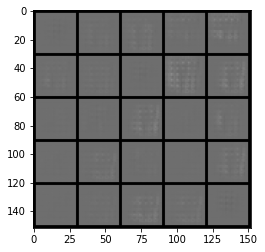

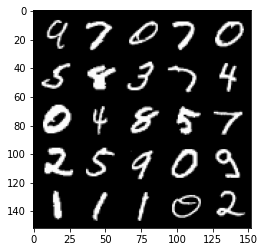

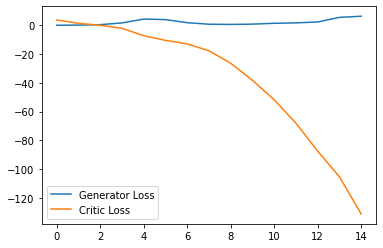

Step 350: Generator loss: 8.902450866699219, critic loss: -169.17289840698243


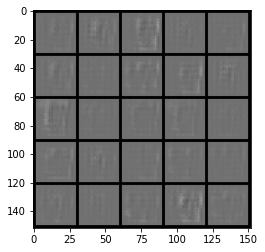

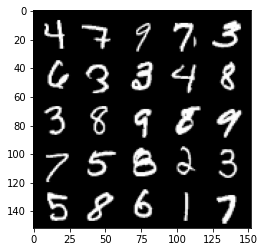

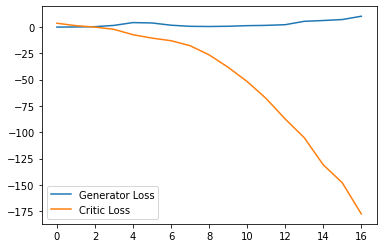

Step 400: Generator loss: 11.056829870343208, critic loss: -228.1256035766601


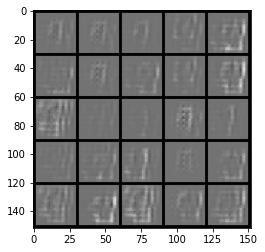

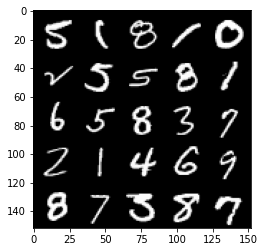

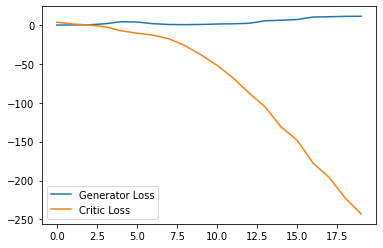

Step 450: Generator loss: 5.319326286315918, critic loss: -267.0397114868164


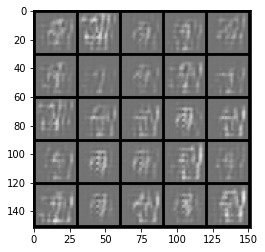

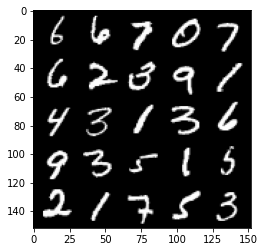

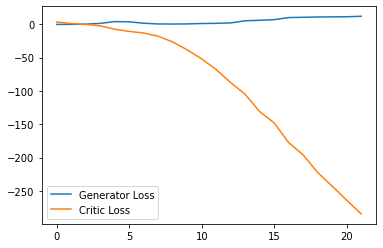

Step 500: Generator loss: 9.485825514793396, critic loss: -310.91359927368165


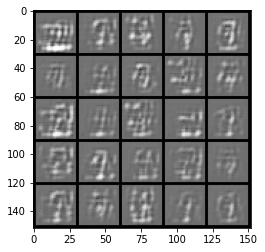

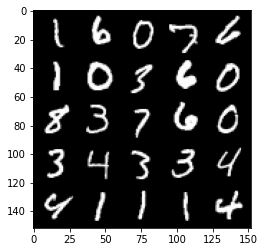

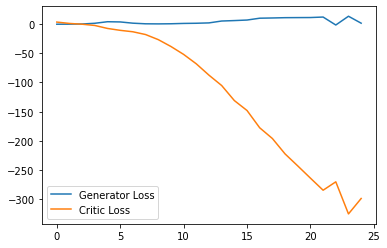

Step 550: Generator loss: -29.886536016464234, critic loss: -263.8213871612548


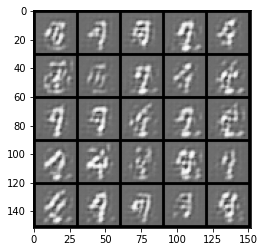

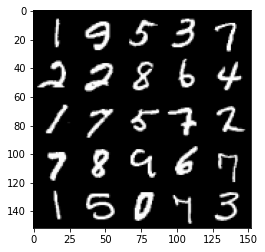

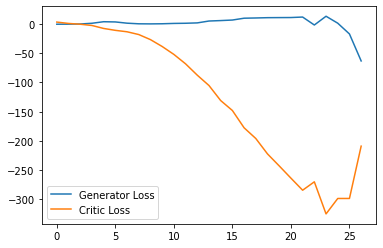

Step 600: Generator loss: 17.986668305397032, critic loss: -377.23900134277324


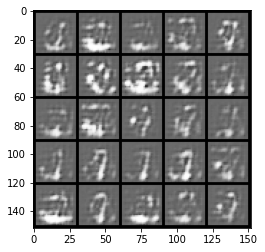

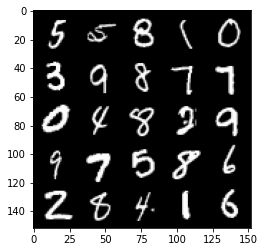

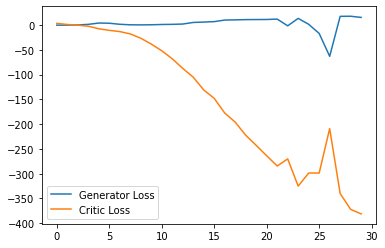

Step 650: Generator loss: -7.279927952289581, critic loss: -335.15161251831057


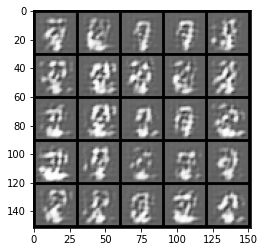

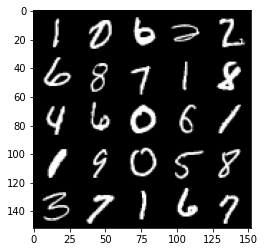

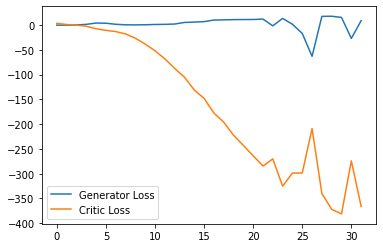

Step 700: Generator loss: -25.294105088710786, critic loss: -323.452891998291


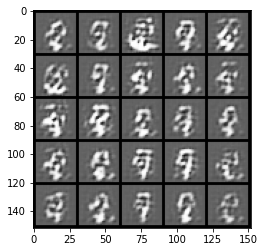

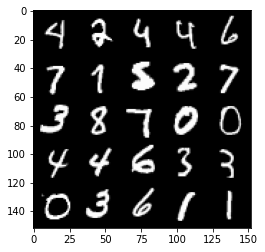

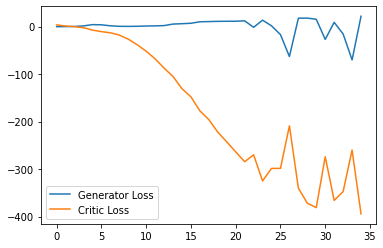

Step 750: Generator loss: -6.064213662743568, critic loss: -378.0062723693848


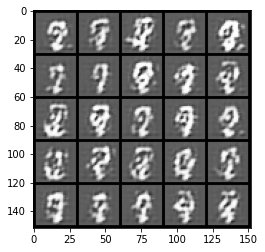

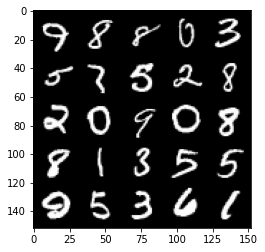

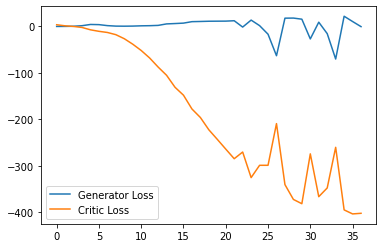

Step 800: Generator loss: -22.969101405441762, critic loss: -345.9067104187011


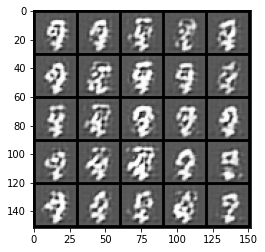

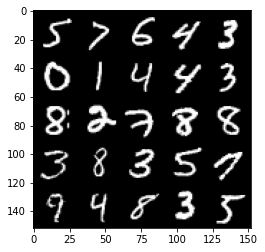

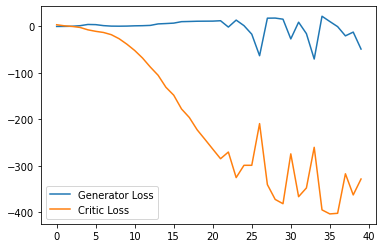

Step 850: Generator loss: -24.34365036010742, critic loss: -335.99281356811514


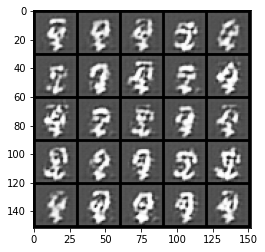

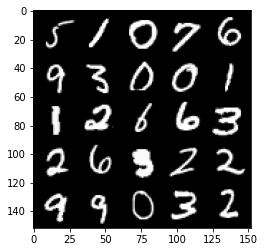

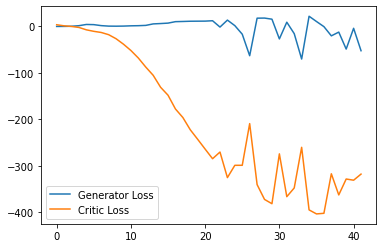

Step 900: Generator loss: -32.650649363994596, critic loss: -293.6890669555664


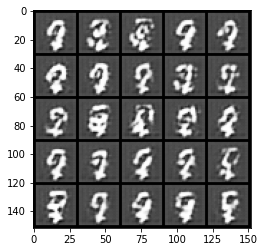

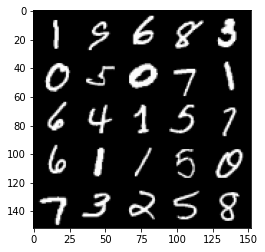

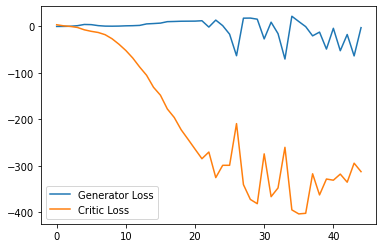

Step 950: Generator loss: -31.442638800144195, critic loss: -306.07291619873047


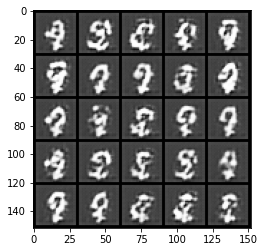

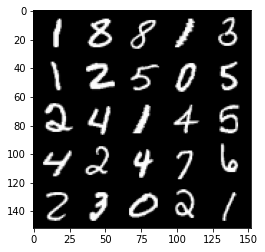

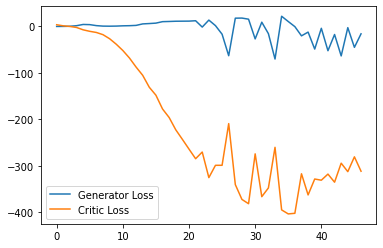

Step 1000: Generator loss: -27.03016679763794, critic loss: -282.00116903686524


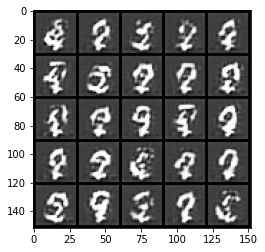

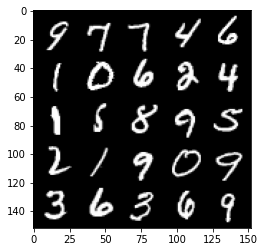

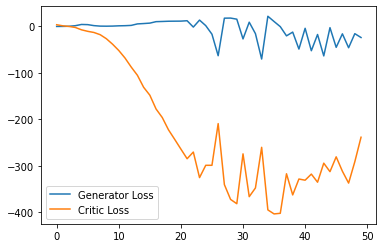

Step 1050: Generator loss: -53.42448476076126, critic loss: -194.38660169982913


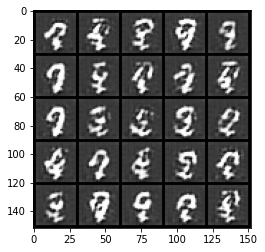

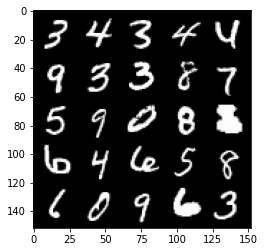

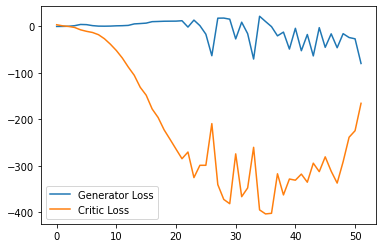

Step 1100: Generator loss: -47.91216571688652, critic loss: -164.65105437469484


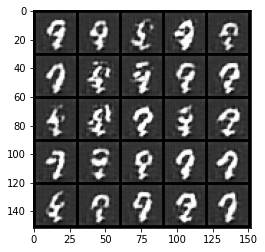

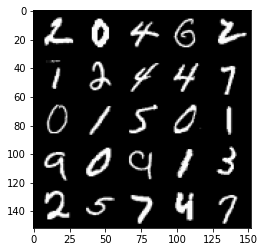

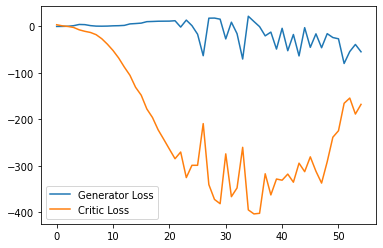

Step 1150: Generator loss: -0.688759946078062, critic loss: 62.82249568748479


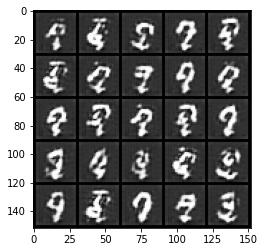

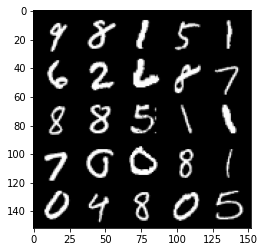

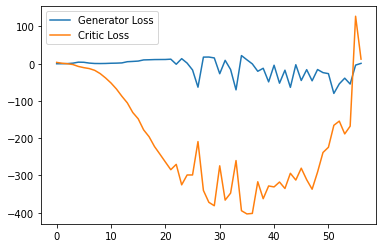

Step 1200: Generator loss: 2.295232436656952, critic loss: 8.542884141921999


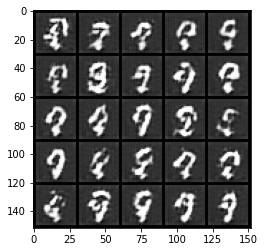

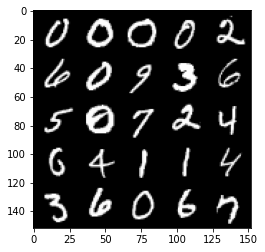

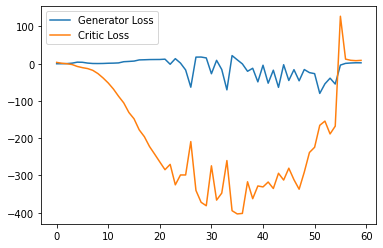

Step 1250: Generator loss: 2.166151967048645, critic loss: 5.000536745071412


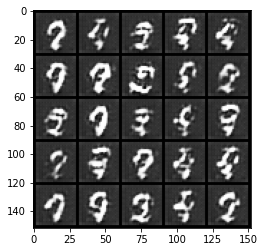

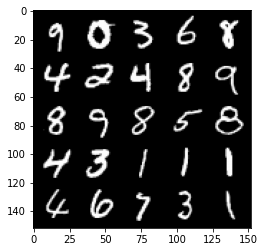

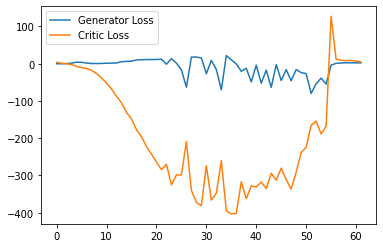

Step 1300: Generator loss: 1.5685335385799408, critic loss: 0.5569179935455321


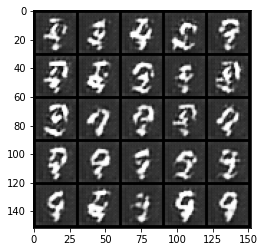

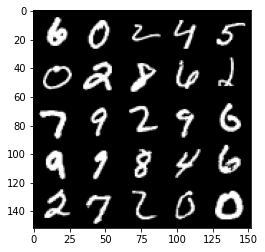

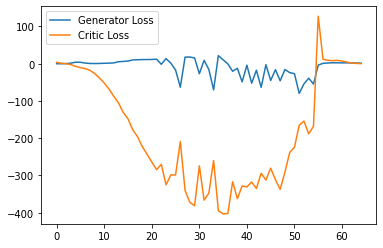

Step 1350: Generator loss: 0.09664834529161453, critic loss: 0.9703116226196287


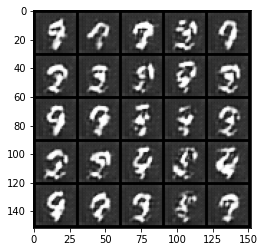

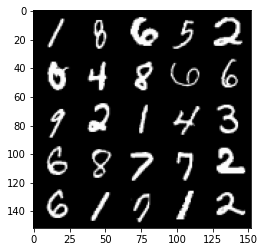

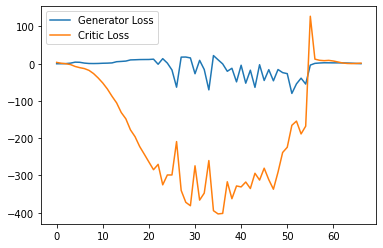

Step 1400: Generator loss: -0.6678857693076133, critic loss: 0.6159664487838746


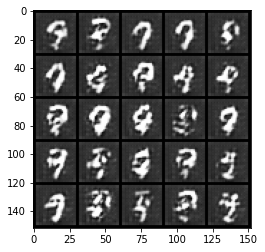

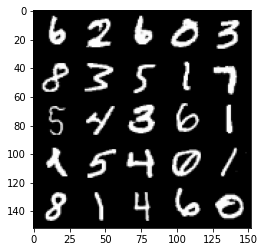

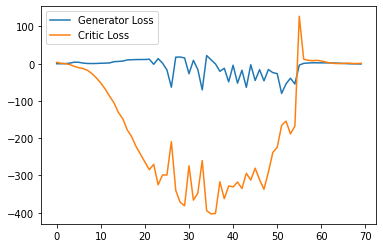

Step 1450: Generator loss: -1.3866683435440064, critic loss: 4.305213356018067


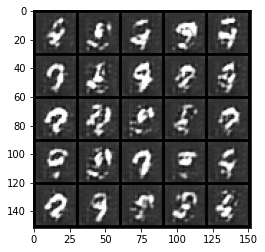

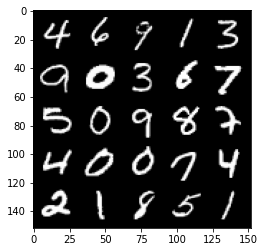

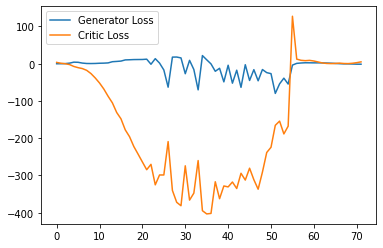

Step 1500: Generator loss: -0.534376659616828, critic loss: 8.691889496803284


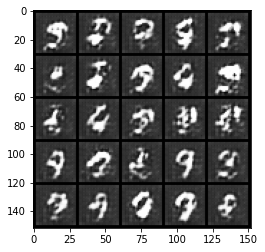

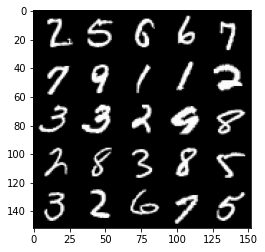

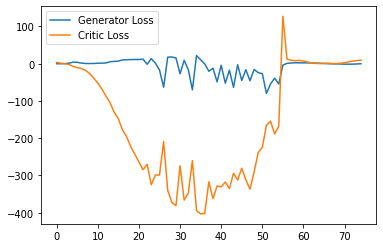

Step 1550: Generator loss: 0.573971143886447, critic loss: 11.189694128036495


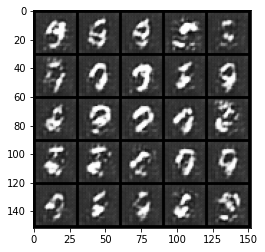

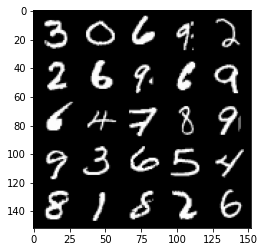

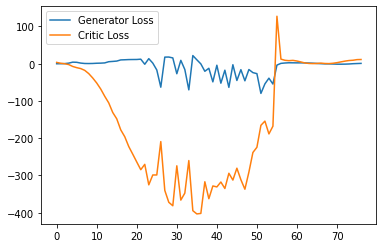

Step 1600: Generator loss: -0.3828311052918434, critic loss: 12.248043251037595


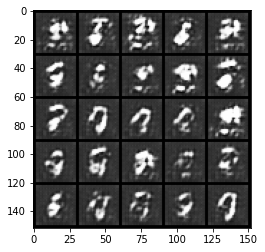

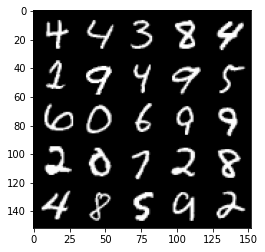

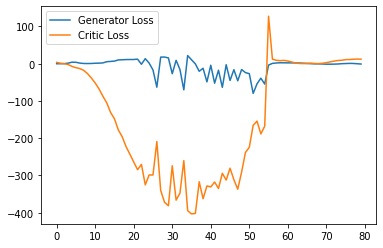

Step 1650: Generator loss: -2.7190124583244324, critic loss: 11.784386473655696


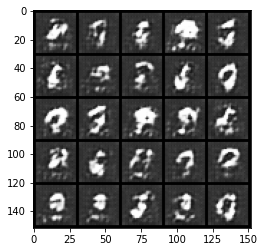

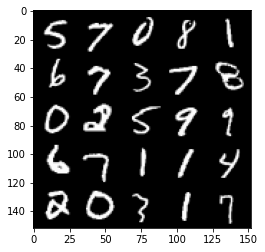

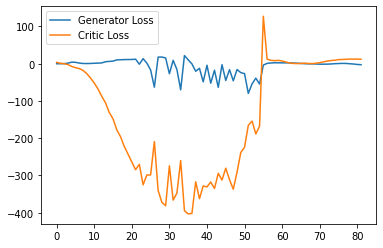

Step 1700: Generator loss: -4.484261445999145, critic loss: 9.341212869644165


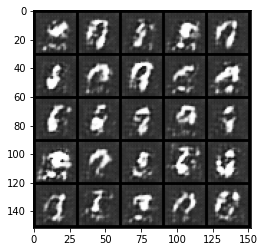

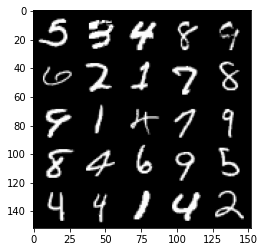

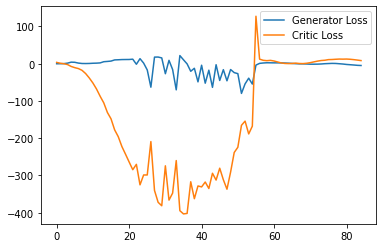

Step 1750: Generator loss: -5.939496040344238, critic loss: 5.666450618743896


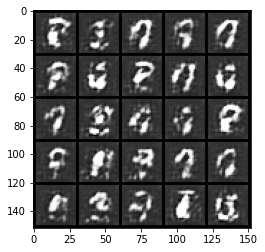

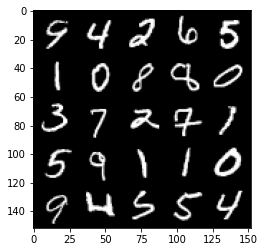

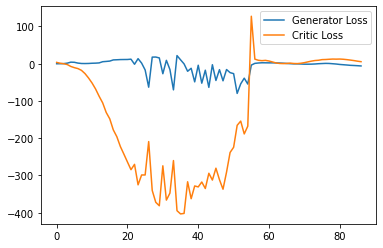

Step 1800: Generator loss: -7.265451154708862, critic loss: 2.812306875228882


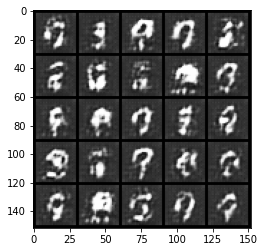

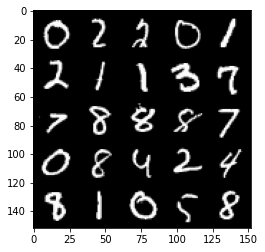

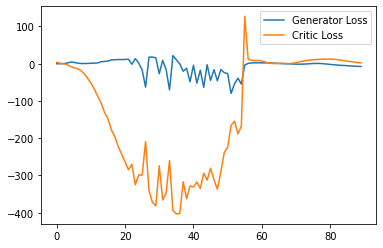

Step 1850: Generator loss: -8.575954914093018, critic loss: 1.248739622116089


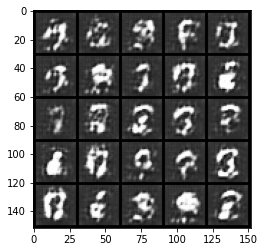

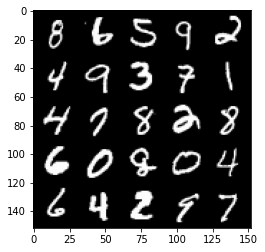

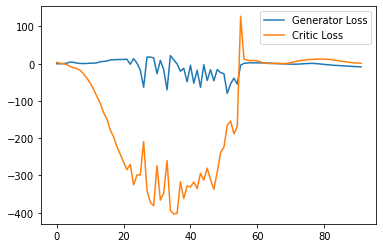

Step 1900: Generator loss: -9.948406333923339, critic loss: 0.5558509931564332


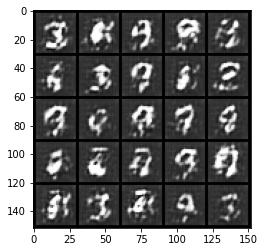

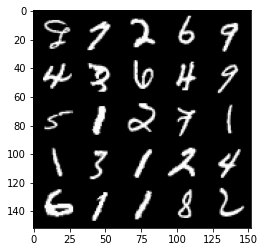

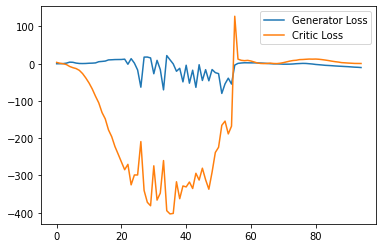

Step 1950: Generator loss: -11.516950588226319, critic loss: 0.1629464731216431


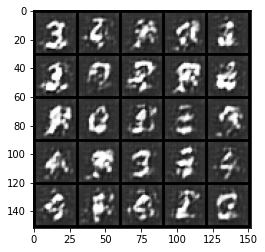

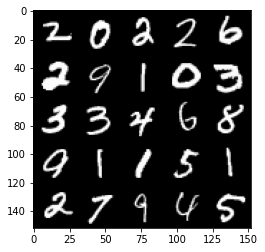

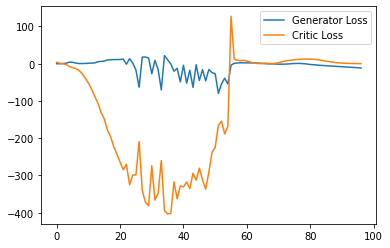

Step 2000: Generator loss: -12.983973903656006, critic loss: -0.40608846092224105


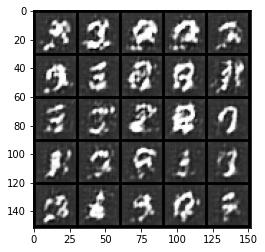

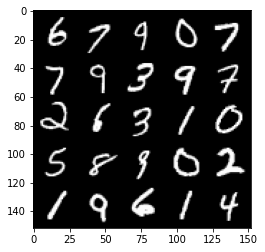

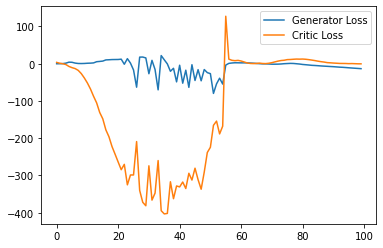

Step 2050: Generator loss: -14.644082221984863, critic loss: -0.5410875263214112


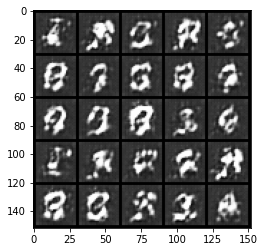

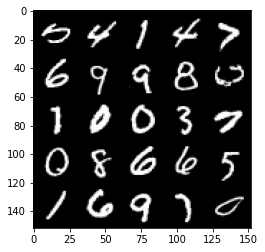

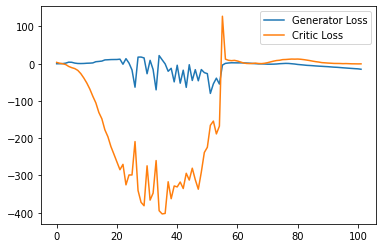

Step 2100: Generator loss: -15.411221351623535, critic loss: -1.5705454769134517


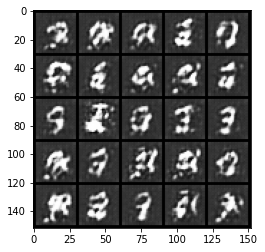

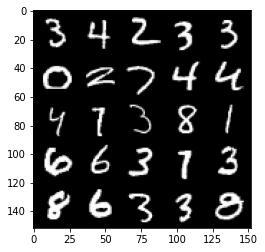

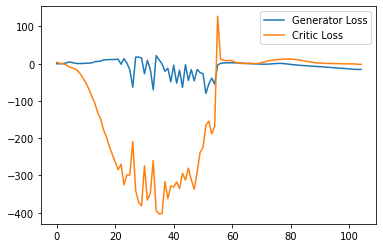

Step 2150: Generator loss: -15.617440242767334, critic loss: -2.5249041423797607


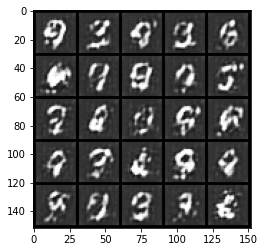

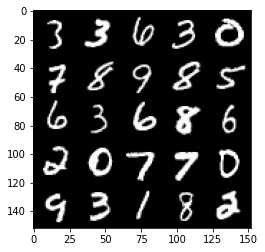

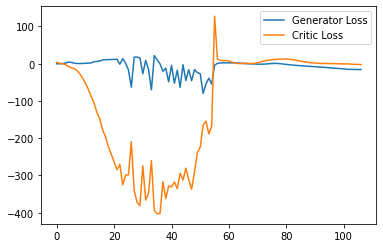

Step 2200: Generator loss: -15.640100021362304, critic loss: -5.249308156967161


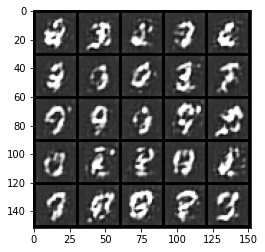

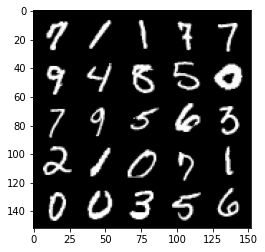

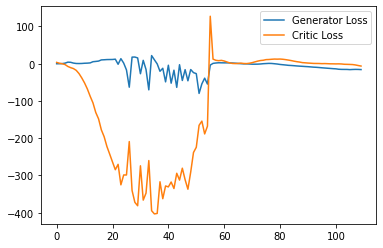

Step 2250: Generator loss: -15.443098754882813, critic loss: -8.813172349929811


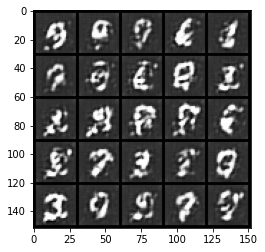

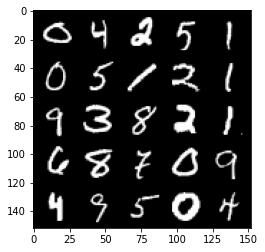

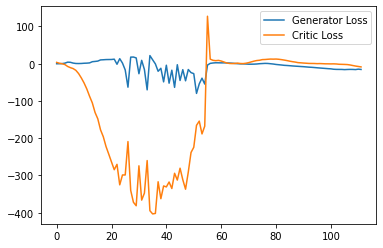

Step 2300: Generator loss: -16.952129154205323, critic loss: -12.196003034591675


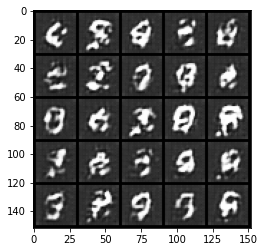

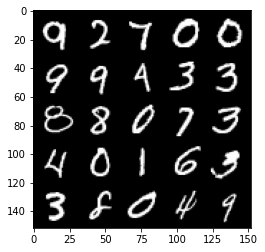

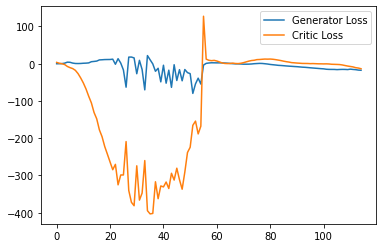

Step 2350: Generator loss: -15.76238819360733, critic loss: -16.777532230377204


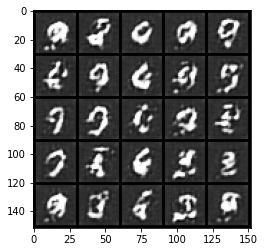

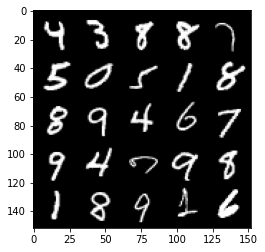

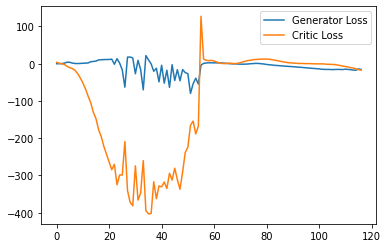

Step 2400: Generator loss: -21.282163887023927, critic loss: -5.044844009399415


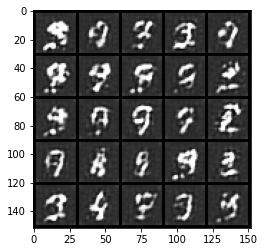

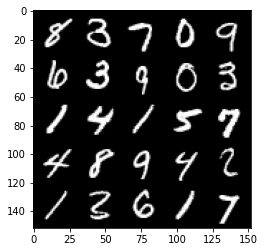

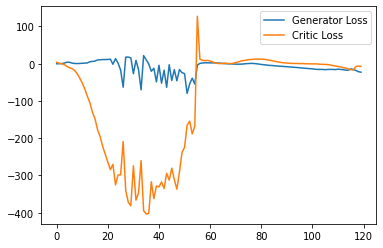

Step 2450: Generator loss: -20.958057384490967, critic loss: -11.086458984375001


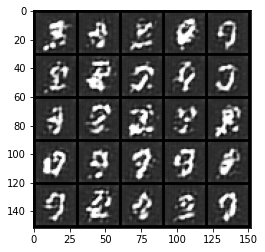

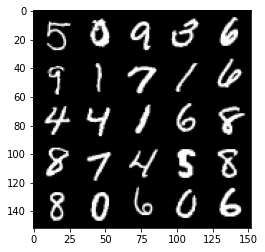

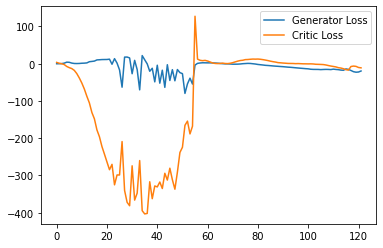

Step 2500: Generator loss: -20.92365879058838, critic loss: -13.117243045806886


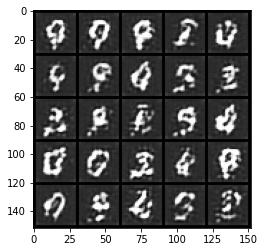

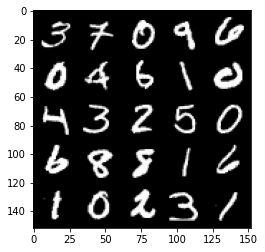

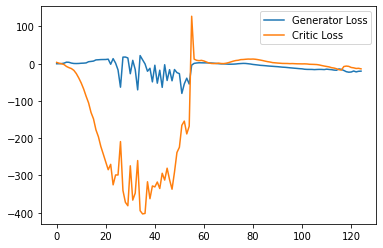

Step 2550: Generator loss: -21.152293148040773, critic loss: -13.468687694549565


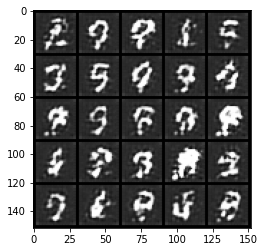

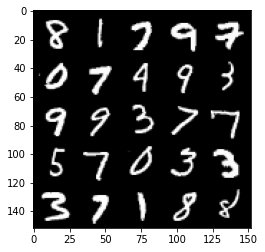

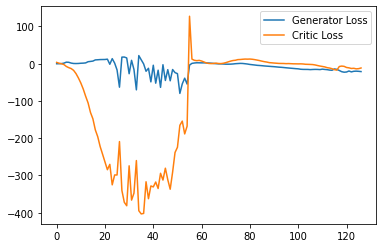

Step 2600: Generator loss: -21.768345911502838, critic loss: -18.95339947128296


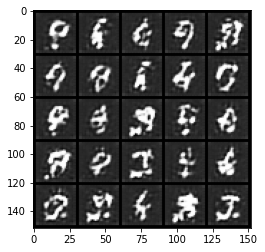

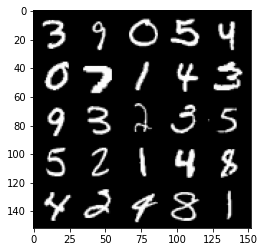

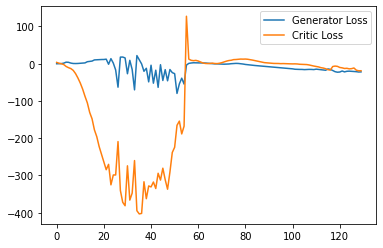

Step 2650: Generator loss: -23.0283083486557, critic loss: -18.478975013732914


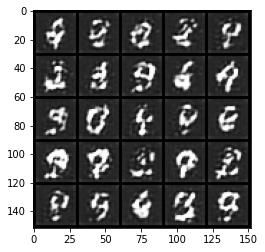

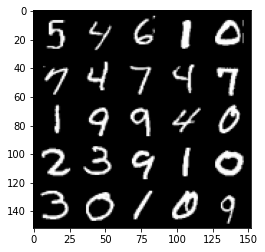

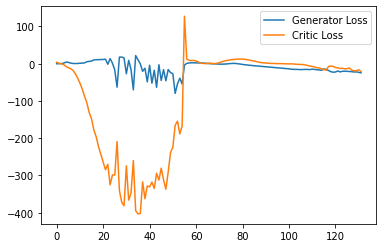

Step 2700: Generator loss: -23.582540912628176, critic loss: -18.394784622192383


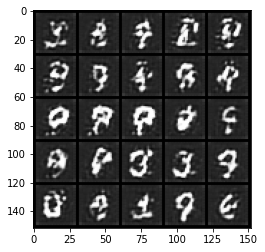

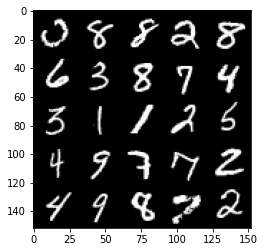

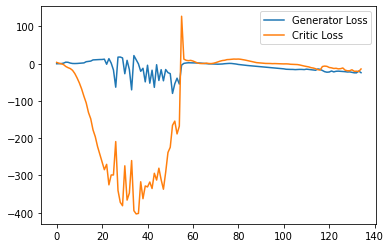

Step 2750: Generator loss: -25.5405917930603, critic loss: -19.410981784820553


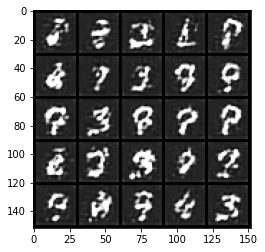

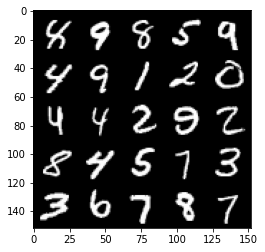

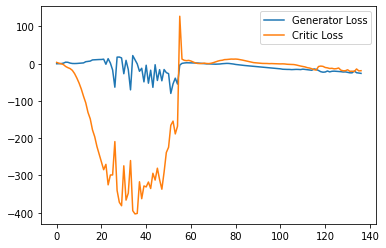

Step 2800: Generator loss: -24.94211917877197, critic loss: -19.88849460029602


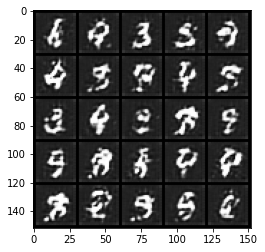

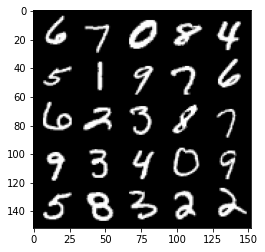

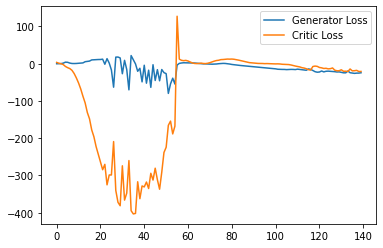

Step 2850: Generator loss: -23.300243792533873, critic loss: -17.62275677871704


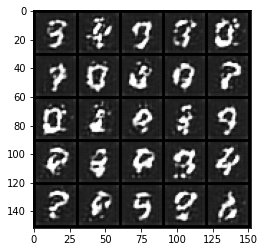

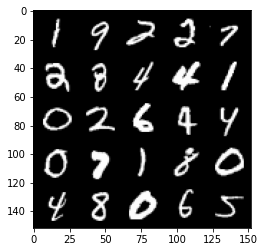

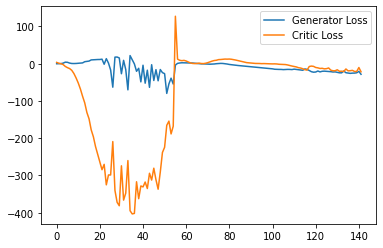

Step 2900: Generator loss: -26.244497051239012, critic loss: -16.58067718887329


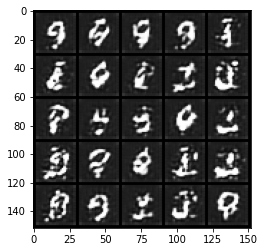

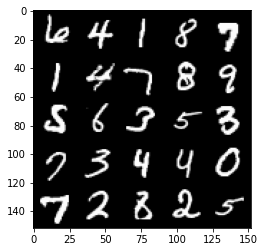

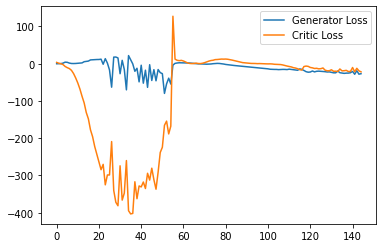

Step 2950: Generator loss: -23.753400173187256, critic loss: -20.25248882865905


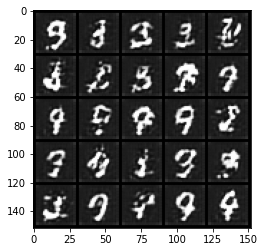

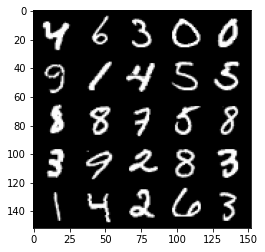

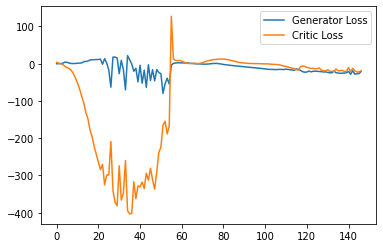

Step 3000: Generator loss: -21.251973382234574, critic loss: -6.198423941612243


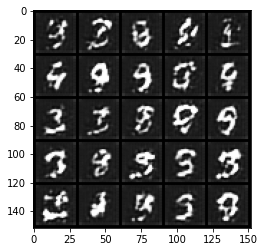

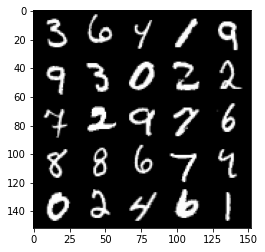

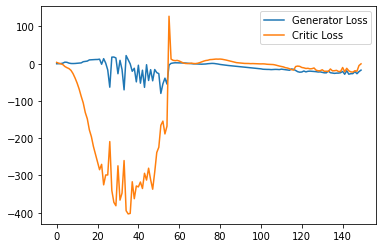

Step 3050: Generator loss: -20.412755699157714, critic loss: -1.3218836822509763


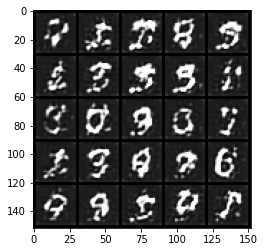

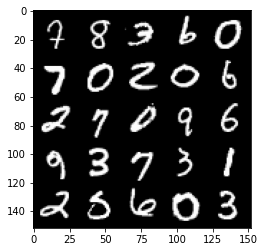

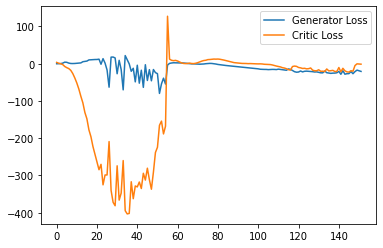

Step 3100: Generator loss: -27.72926181793213, critic loss: -13.678443045616152


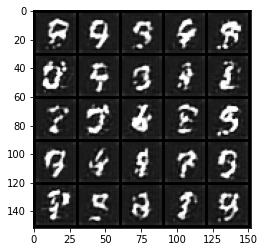

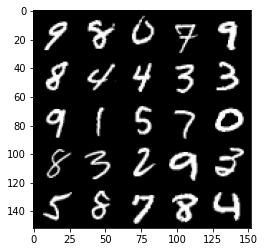

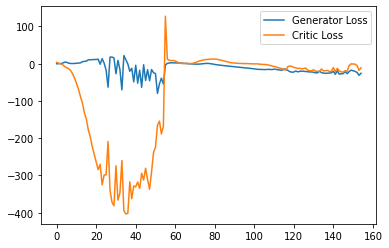

Step 3150: Generator loss: -19.080788097381593, critic loss: -4.270809205532074


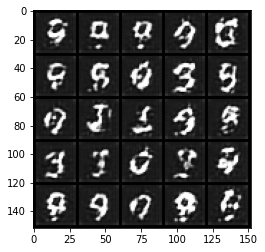

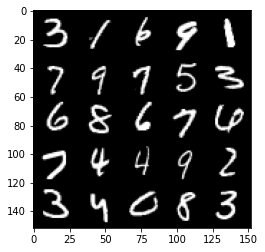

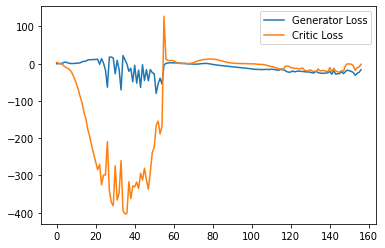

Step 3200: Generator loss: -23.320235900878906, critic loss: -9.234259747505188


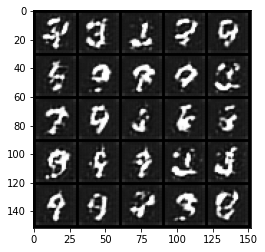

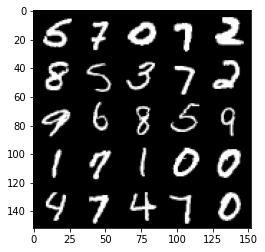

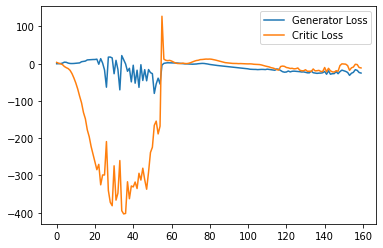

Step 3250: Generator loss: -23.45715606689453, critic loss: -15.744172284126273


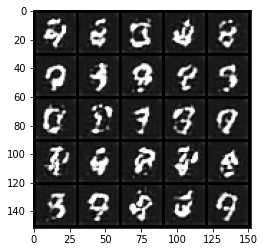

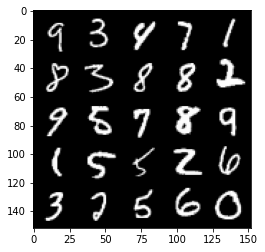

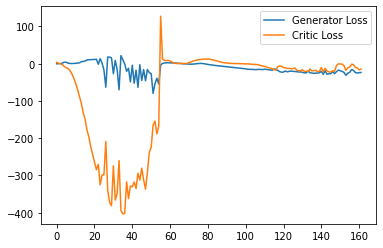

Step 3300: Generator loss: -17.947207889556886, critic loss: -5.728334270000456


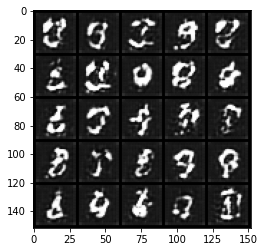

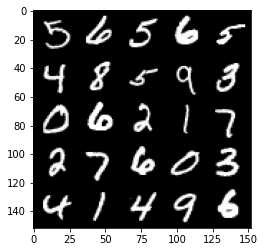

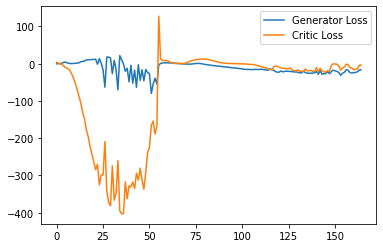

Step 3350: Generator loss: -24.60268795013428, critic loss: -15.367858198165901


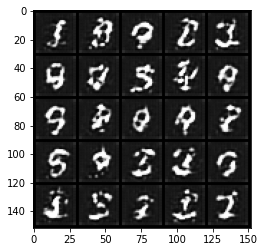

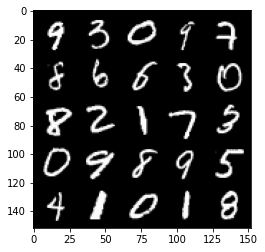

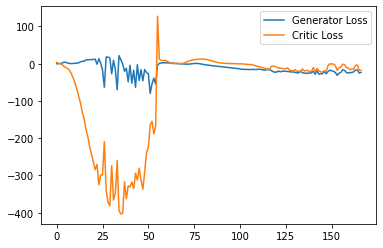

Step 3400: Generator loss: -15.568757247924804, critic loss: -4.088516539573669


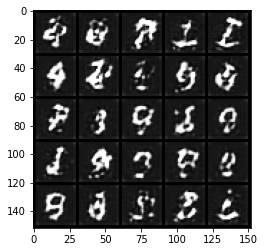

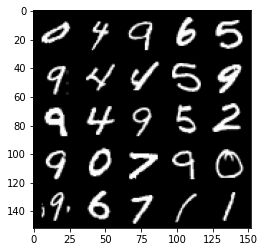

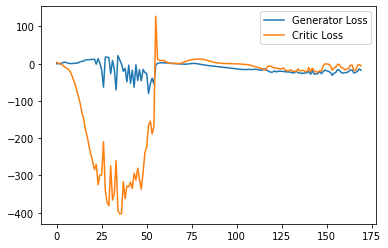

Step 3450: Generator loss: -22.9630143737793, critic loss: -14.867303144454956


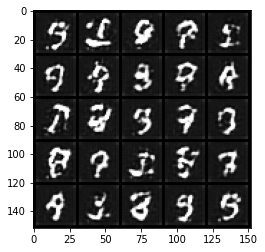

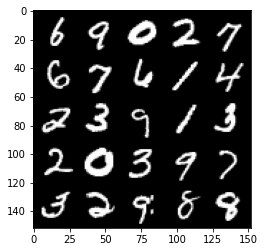

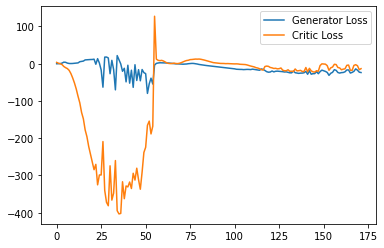

Step 3500: Generator loss: -14.446659622192383, critic loss: -4.889975957870485


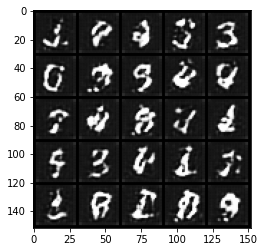

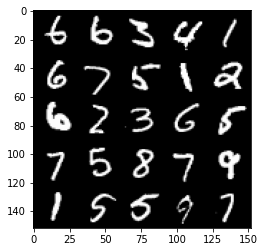

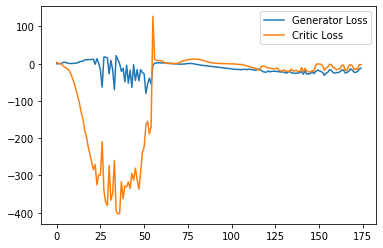

Step 3550: Generator loss: -19.788838386535645, critic loss: -13.810178483963016


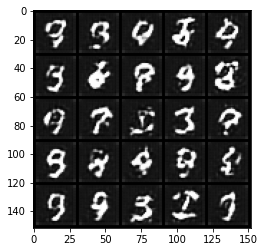

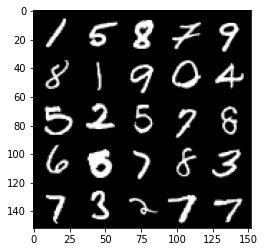

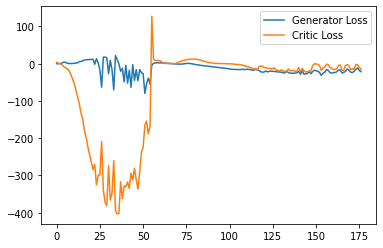

Step 3600: Generator loss: -17.02191906452179, critic loss: -10.62562611103058


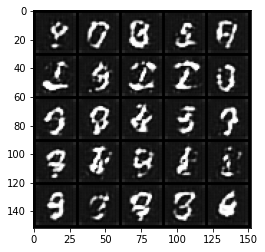

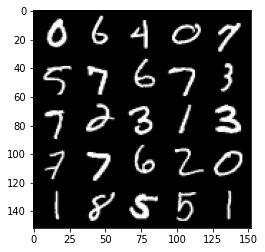

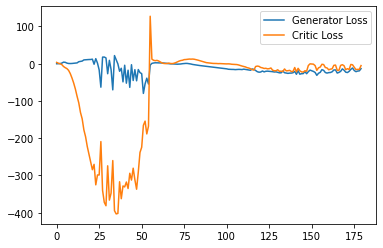

Step 3650: Generator loss: -14.588099727630615, critic loss: -8.722284150123595


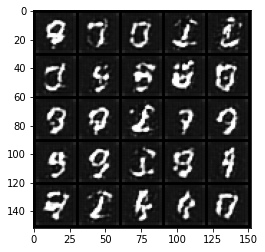

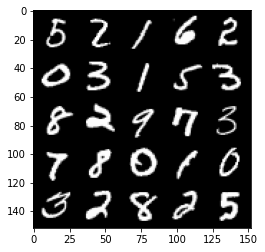

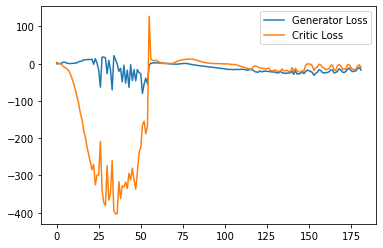

Step 3700: Generator loss: -9.604824771881104, critic loss: 1.2871369423866272


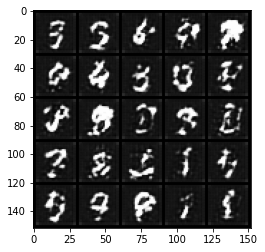

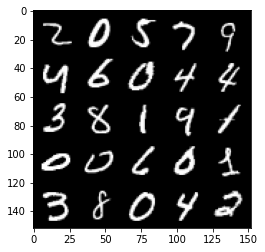

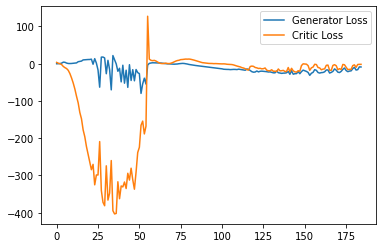

Step 3750: Generator loss: -11.1467716217041, critic loss: -1.8128400692939763


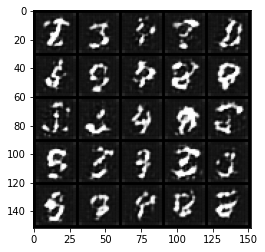

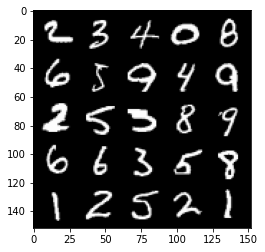

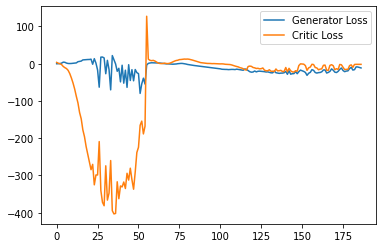

Step 3800: Generator loss: -13.646011924743652, critic loss: -1.947617587089539


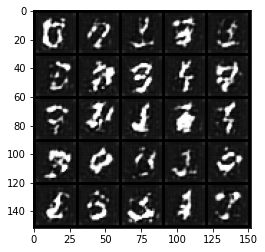

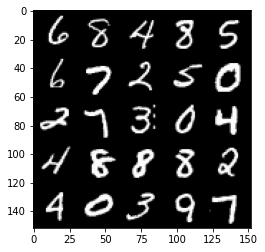

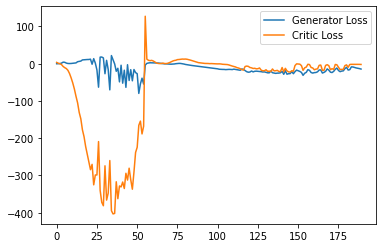

Step 3850: Generator loss: -15.11127607345581, critic loss: -2.339034290313721


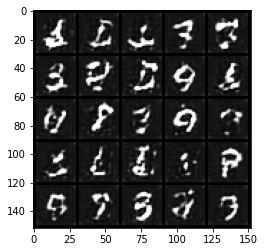

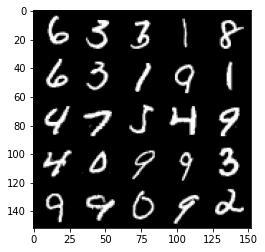

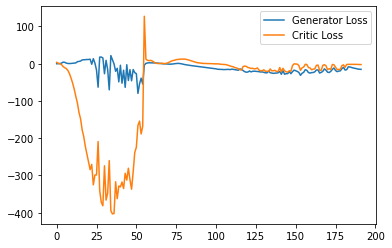

Step 3900: Generator loss: -15.934040851593018, critic loss: -2.9242070097923283


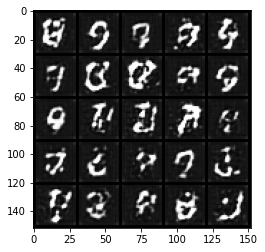

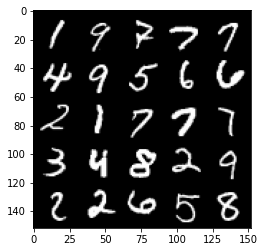

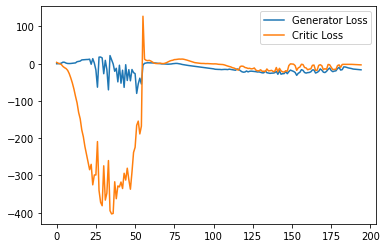

Step 3950: Generator loss: -20.29748062133789, critic loss: -12.110333207130434


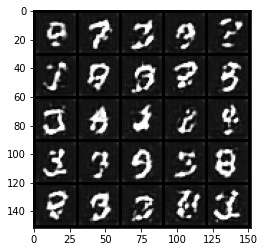

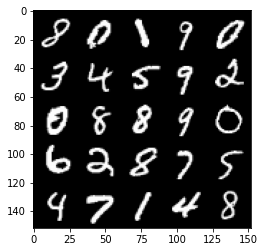

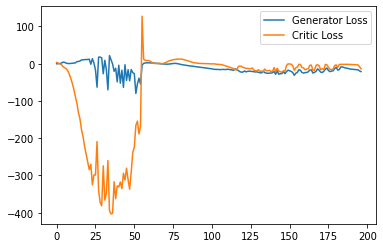

Step 4000: Generator loss: -10.478401327133179, critic loss: -0.6762841081619264


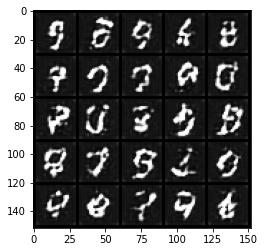

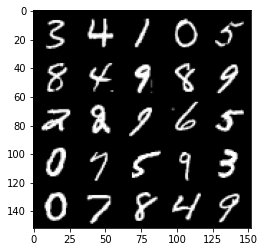

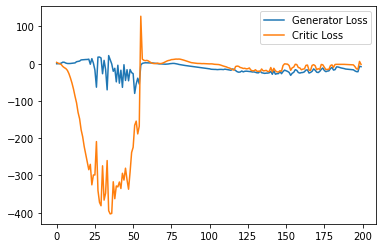

Step 4050: Generator loss: -10.630703086853027, critic loss: -1.9748178462982173


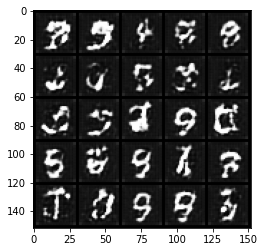

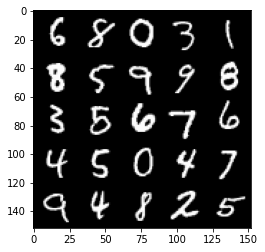

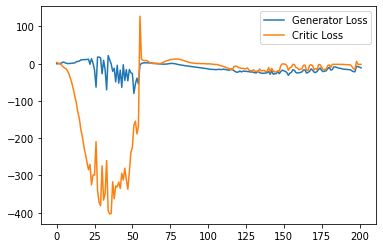

Step 4100: Generator loss: -13.399389019012451, critic loss: -2.2308536996841433


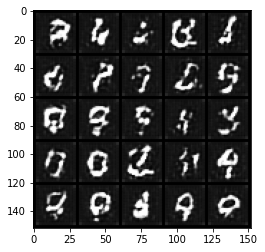

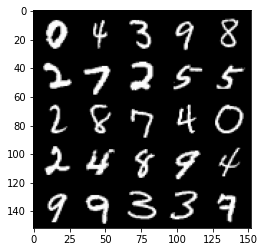

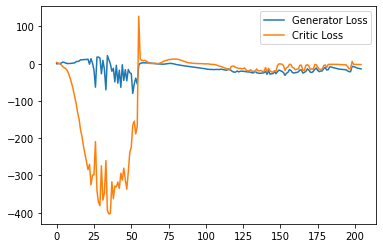

Step 4150: Generator loss: -14.652891902923583, critic loss: -2.6445923194885252


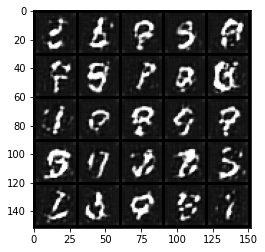

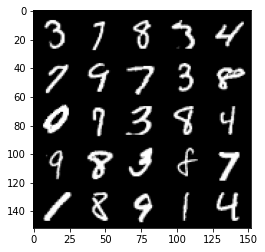

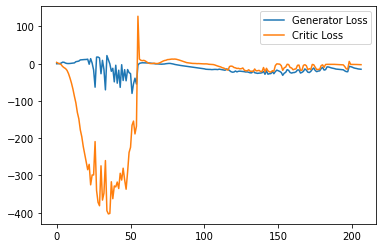

Step 4200: Generator loss: -17.39244087219238, critic loss: -7.668497875213624


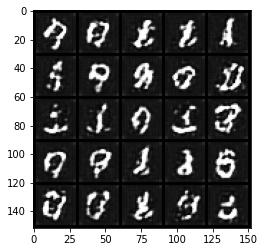

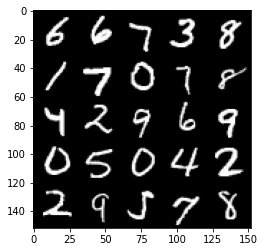

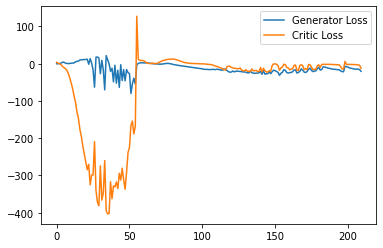

Step 4250: Generator loss: -11.19252760887146, critic loss: -5.3689165039062505


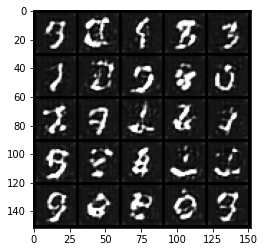

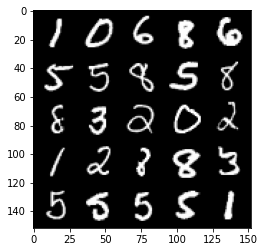

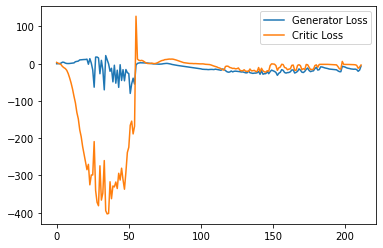

Step 4300: Generator loss: -15.228278031349182, critic loss: -12.244360533714296


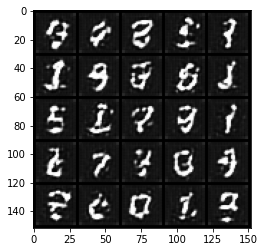

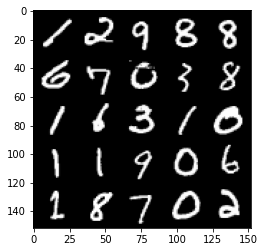

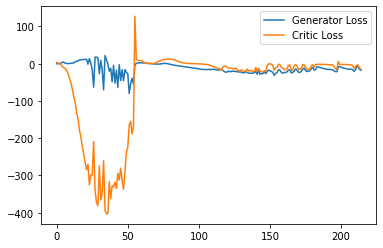

Step 4350: Generator loss: -11.336908025741577, critic loss: -7.604116756439209


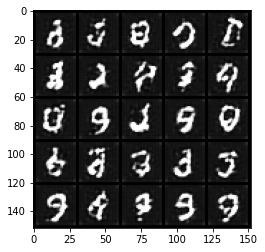

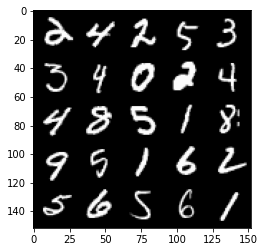

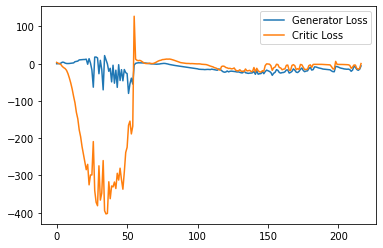

Step 4400: Generator loss: -11.489988222122193, critic loss: -14.253966012954715


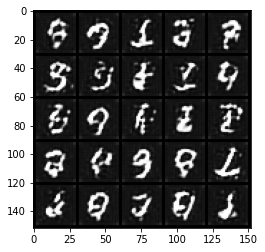

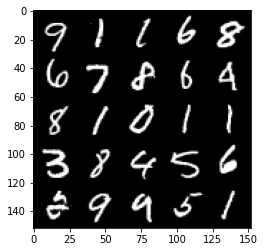

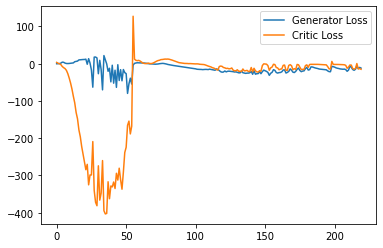

Step 4450: Generator loss: -10.994039735794068, critic loss: -13.170689461708069


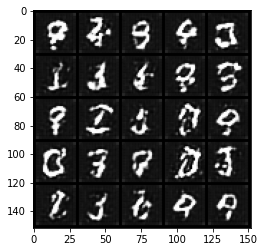

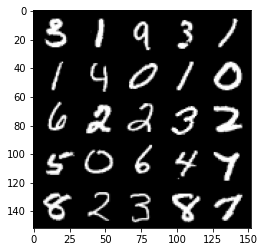

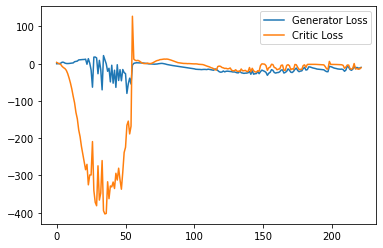

Step 4500: Generator loss: -9.122326951920986, critic loss: -7.904520483970645


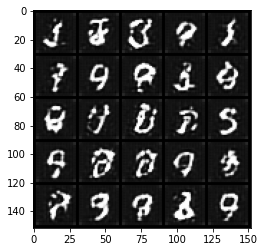

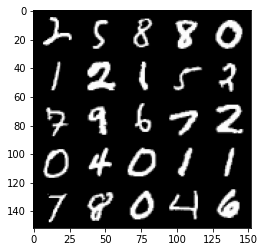

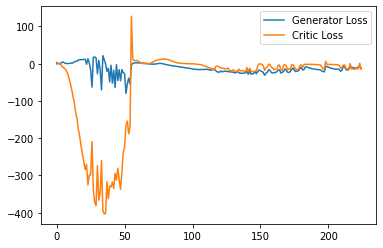

Step 4550: Generator loss: -5.968670585155487, critic loss: -10.392466180801394


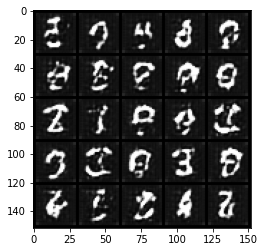

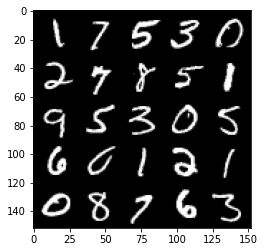

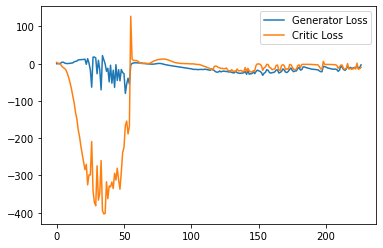

Step 4600: Generator loss: -8.721160709261895, critic loss: -13.382270668029784


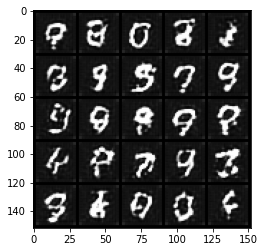

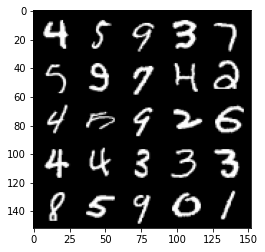

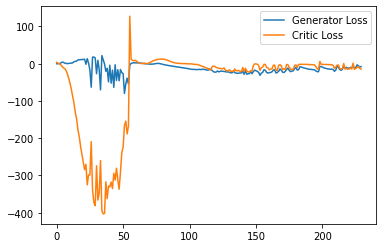

Step 4650: Generator loss: -7.178191489577293, critic loss: -14.568386067390446


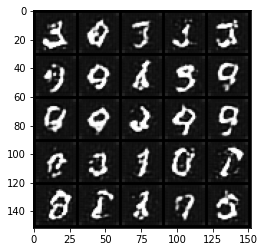

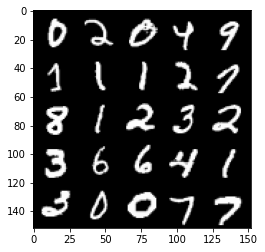

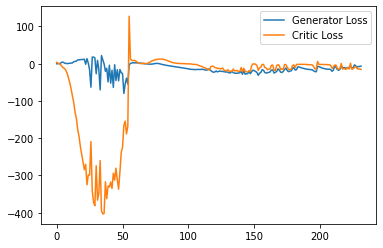

Step 4700: Generator loss: -5.174371793270111, critic loss: -14.279698043346409


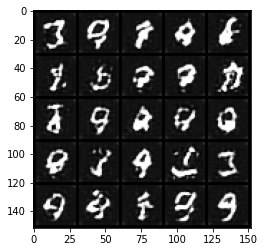

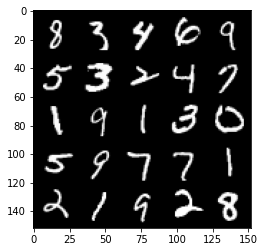

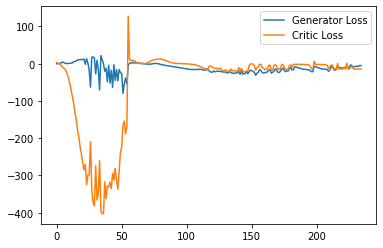

Step 4750: Generator loss: -2.757339326441288, critic loss: -11.810843417167664


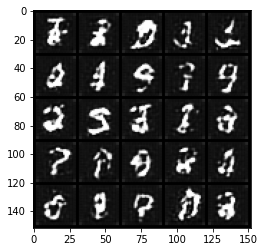

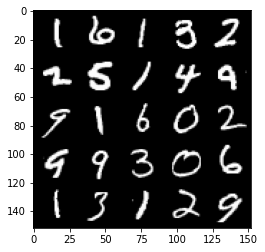

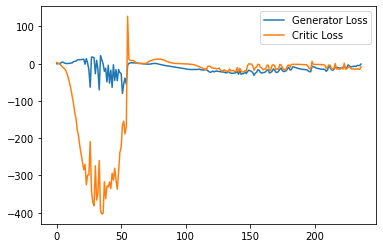

Step 4800: Generator loss: -3.951243082284927, critic loss: -15.5143274936676


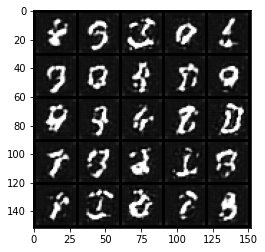

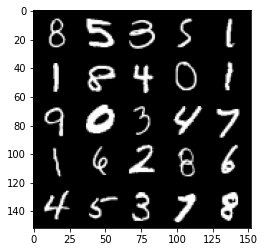

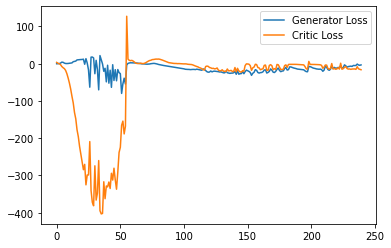

Step 4850: Generator loss: 4.529503254890442, critic loss: 1.4185037841796886


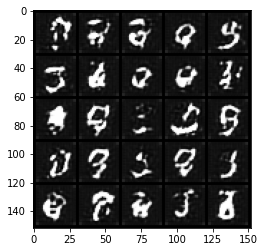

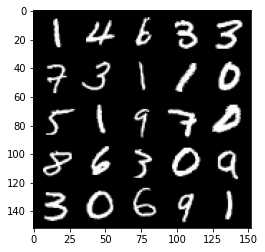

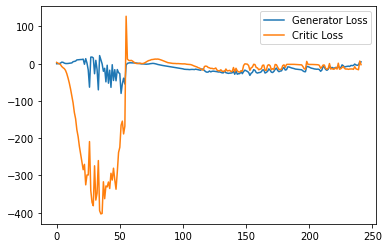

Step 4900: Generator loss: 0.9623268495500088, critic loss: -3.0465118904113755


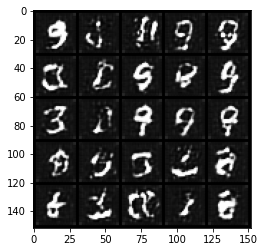

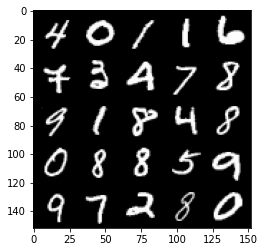

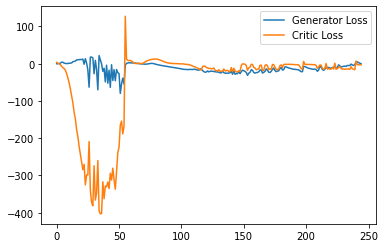

Step 4950: Generator loss: -1.748463457673788, critic loss: -4.255600880622864


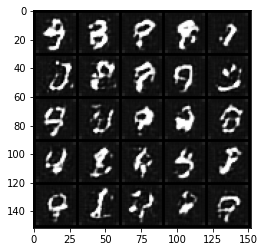

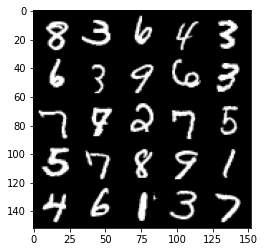

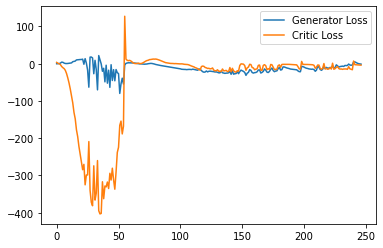

Step 5000: Generator loss: -6.364880217313766, critic loss: -13.68030398988724


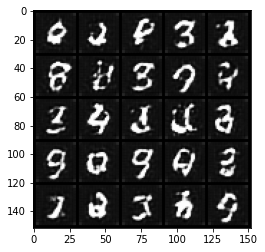

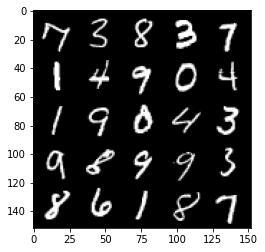

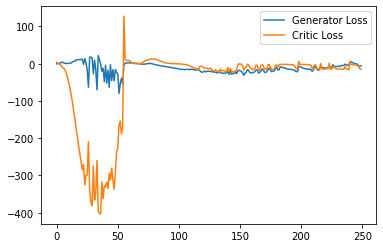

Step 5050: Generator loss: -3.510398019552231, critic loss: -15.592427185058593


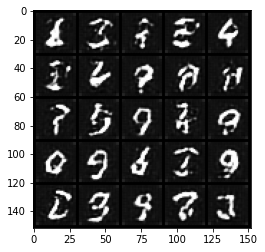

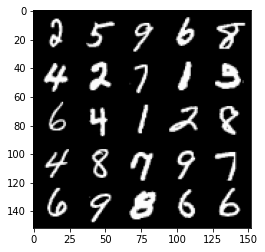

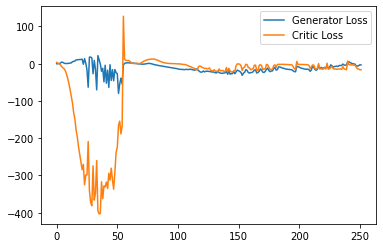

Step 5100: Generator loss: -0.37969389498233796, critic loss: -13.689502607345581


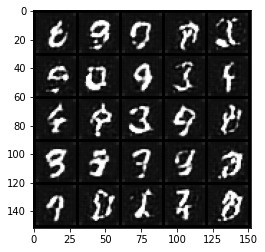

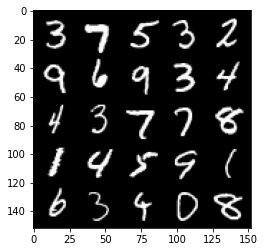

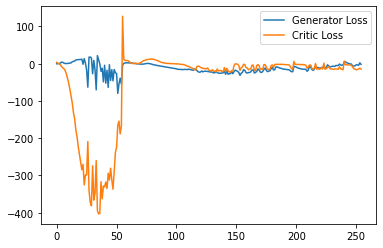

Step 5150: Generator loss: -0.9265314149856567, critic loss: -13.466978500366213


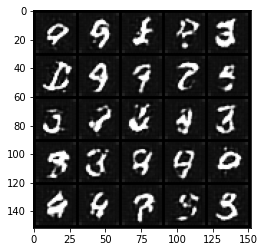

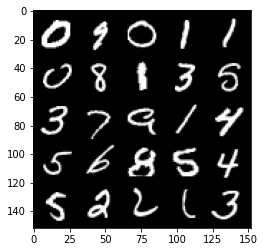

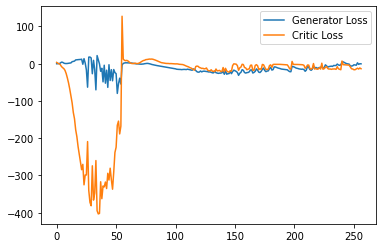

Step 5200: Generator loss: -1.0737992757558823, critic loss: -15.744360996723174


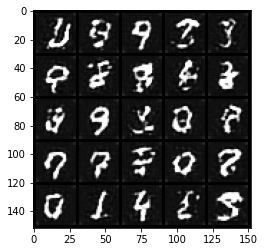

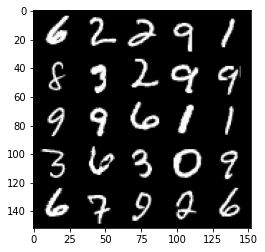

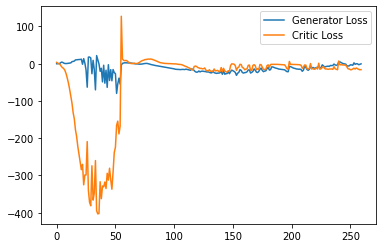

Step 5250: Generator loss: 1.5705638402700424, critic loss: -12.33646300411224


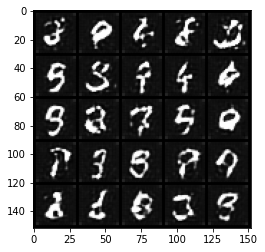

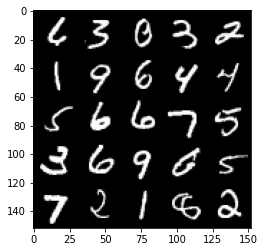

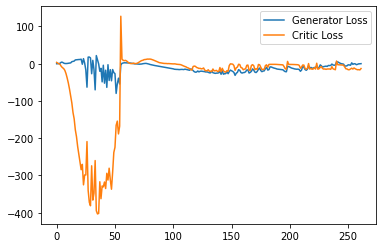

Step 5300: Generator loss: -0.09781119525432587, critic loss: -13.102789835453034


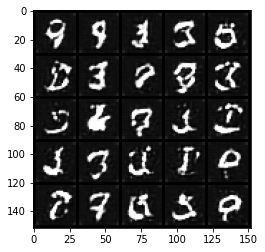

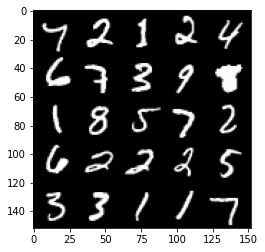

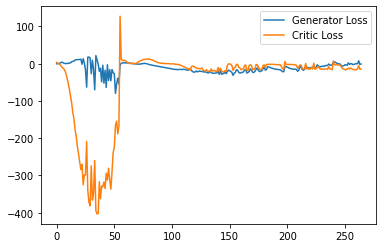

Step 5350: Generator loss: -0.2978214764595032, critic loss: -14.814363387107846


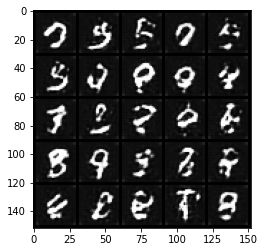

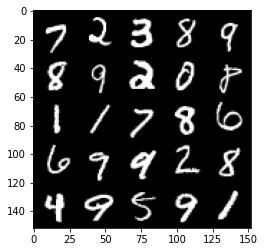

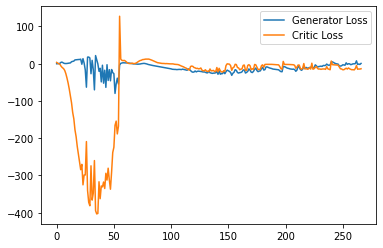

Step 5400: Generator loss: 3.327775849699974, critic loss: -5.614983425140384


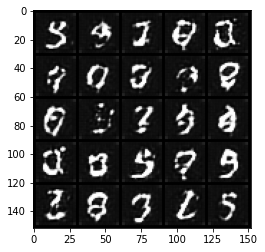

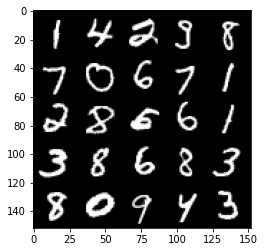

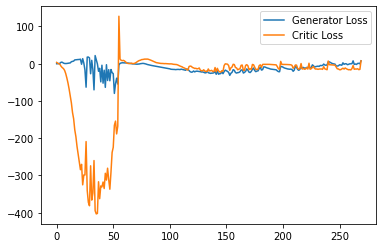

Step 5450: Generator loss: 9.339314260482787, critic loss: -2.2014219174385077


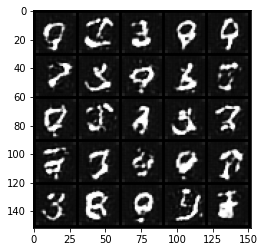

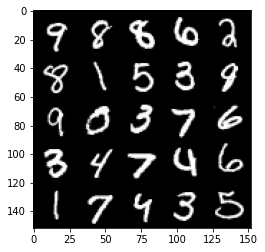

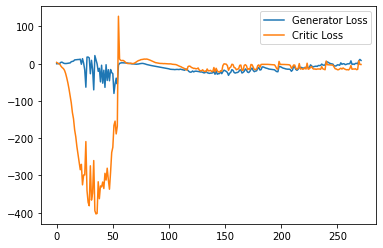

Step 5500: Generator loss: 5.446030359268189, critic loss: -2.6524329624176026


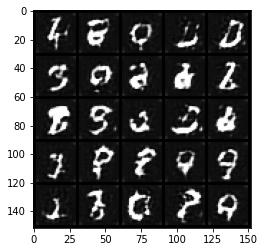

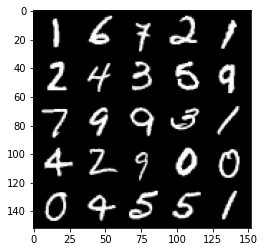

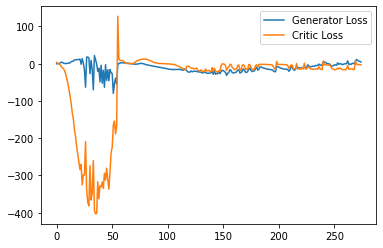

Step 5550: Generator loss: 3.4977684354782106, critic loss: -2.818919404029846


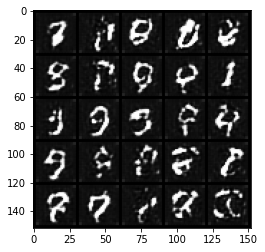

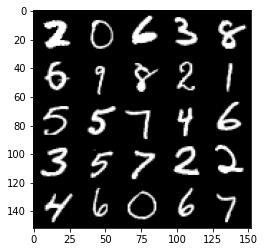

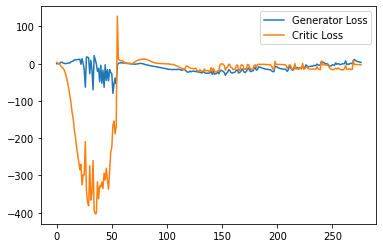

Step 5600: Generator loss: 3.2531150197982788, critic loss: -3.2118002376556394


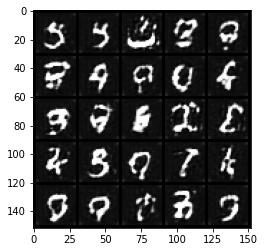

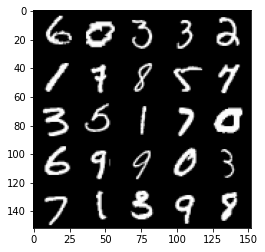

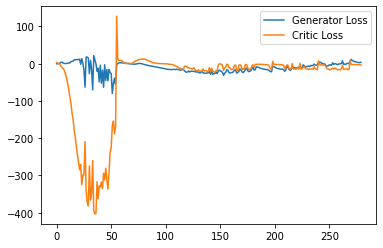

Step 5650: Generator loss: -0.56026491522789, critic loss: -8.254150789260864


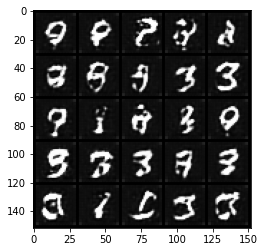

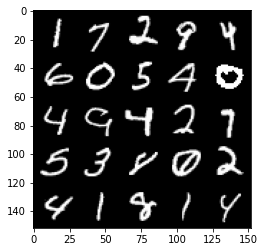

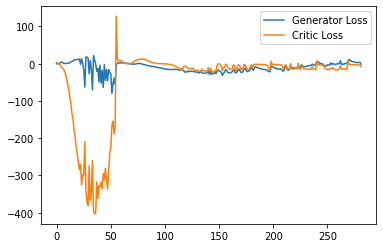

Step 5700: Generator loss: -1.5760279241204262, critic loss: -15.986311982154849


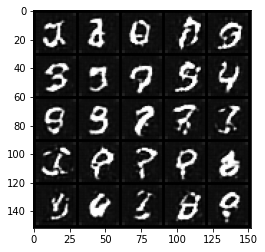

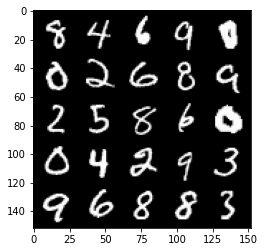

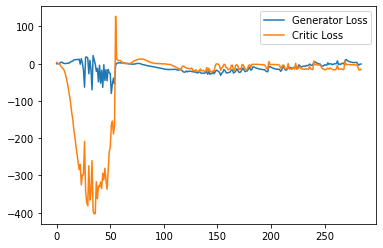

Step 5750: Generator loss: 9.106306562423706, critic loss: -0.6873810977935793


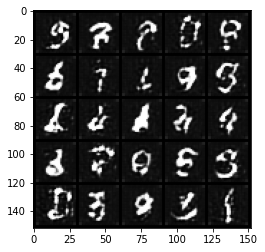

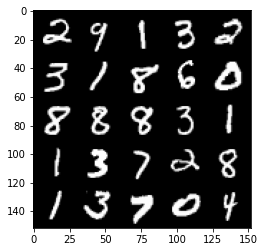

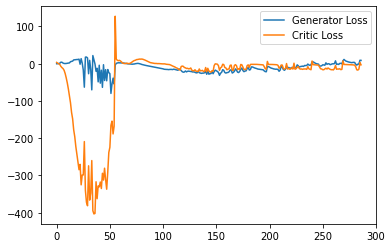

Step 5800: Generator loss: 4.430096228122711, critic loss: -4.811962057113647


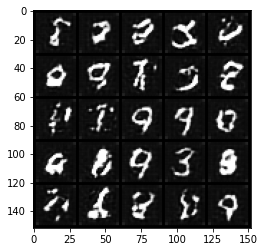

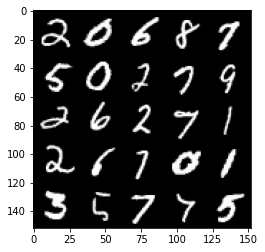

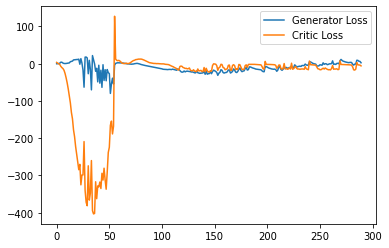

Step 5850: Generator loss: -2.2824221214652063, critic loss: -13.711539751052857


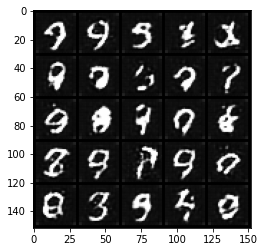

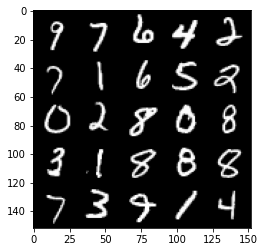

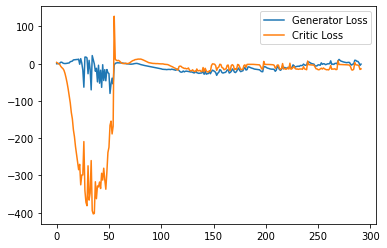

Step 5900: Generator loss: -0.05944895923137665, critic loss: -15.331099540710447


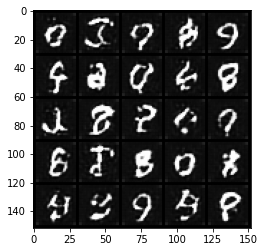

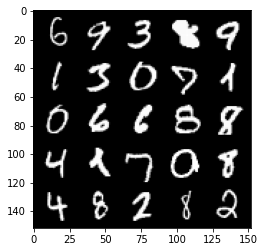

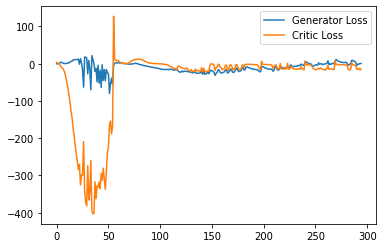

Step 5950: Generator loss: 8.677079164981842, critic loss: 0.7497344136238117


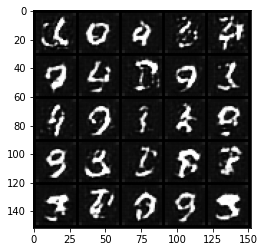

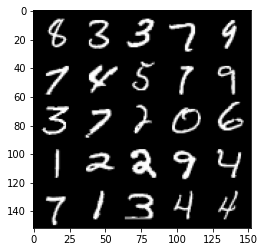

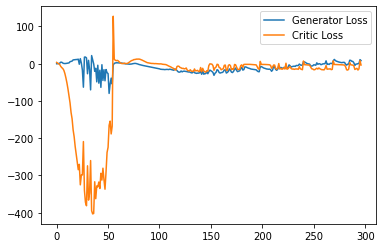

Step 6000: Generator loss: 0.8399832805991173, critic loss: -15.656453455448151


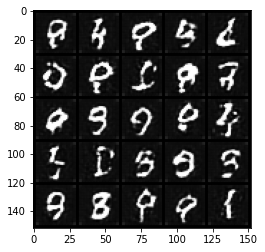

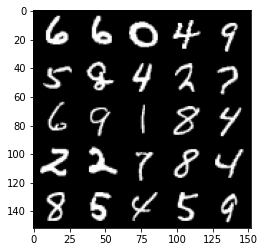

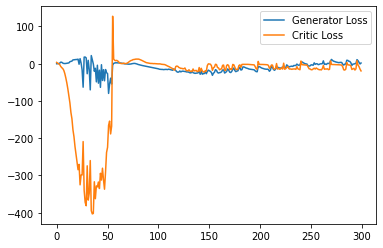

Step 6050: Generator loss: 0.7745908284187317, critic loss: -15.065802985191347


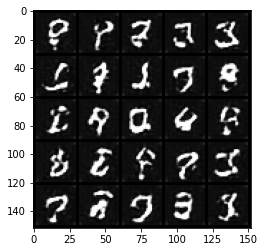

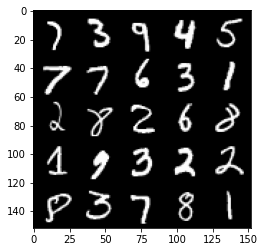

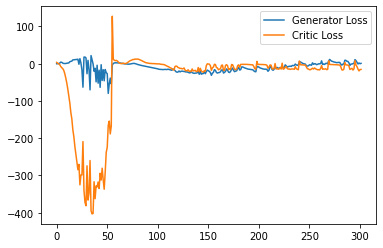

Step 6100: Generator loss: 5.245597179234028, critic loss: -11.96196063041687


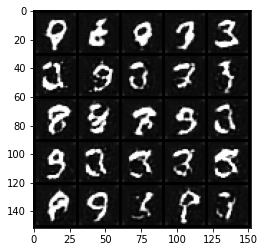

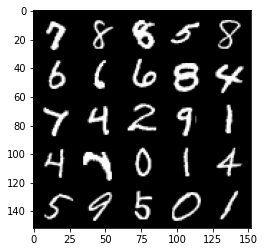

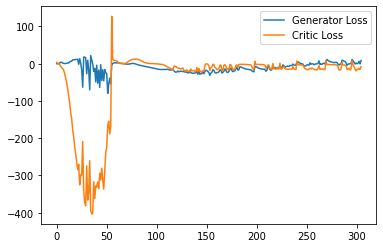

Step 6150: Generator loss: 1.8435484850406647, critic loss: -14.570022828578947


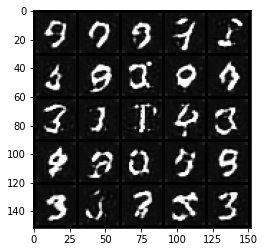

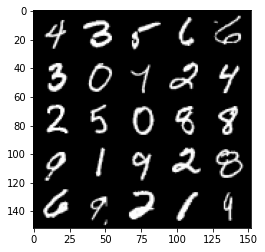

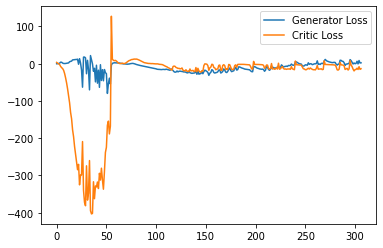

Step 6200: Generator loss: 2.159325591921806, critic loss: -14.143831806182863


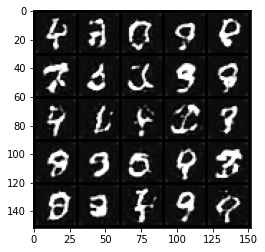

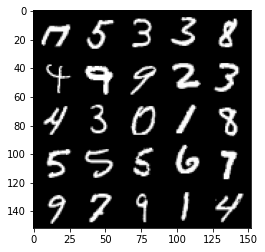

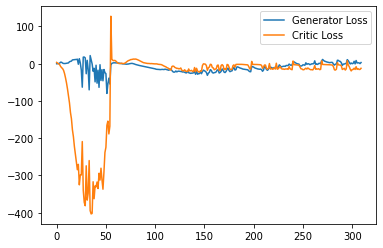

Step 6250: Generator loss: 8.547507695555687, critic loss: -0.7728095636367809


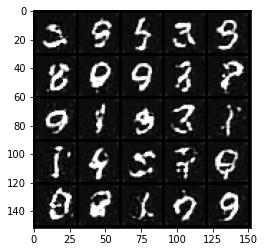

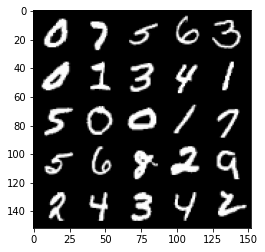

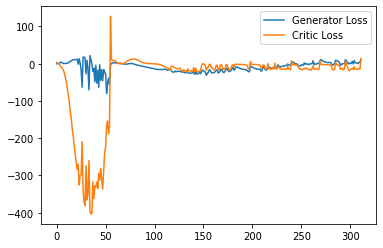

Step 6300: Generator loss: 8.765337104797362, critic loss: -2.9264781103134156


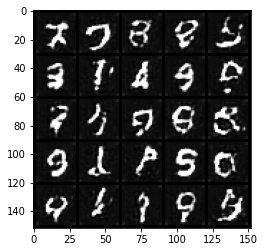

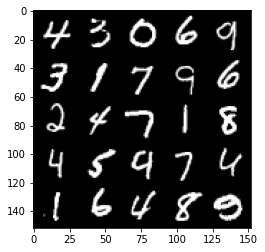

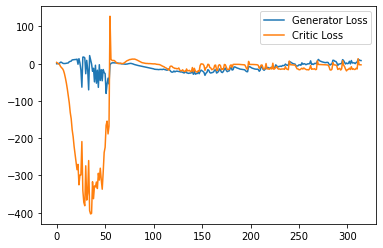

Step 6350: Generator loss: 7.7345187282562256, critic loss: -3.3334190015792844


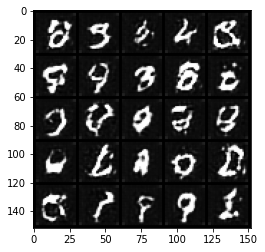

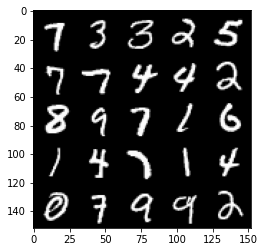

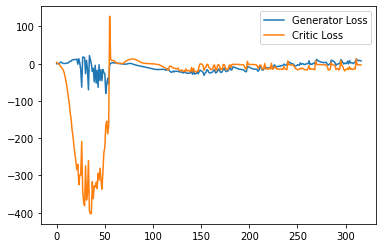

Step 6400: Generator loss: 4.771353825926781, critic loss: -5.074215307235717


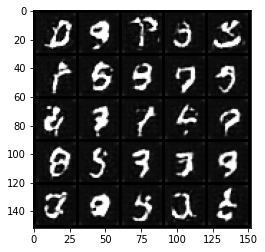

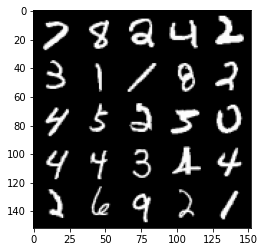

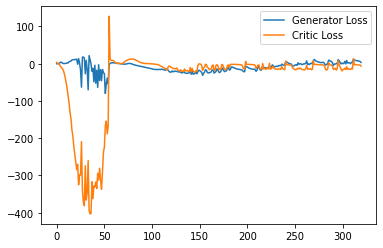

Step 6450: Generator loss: 2.786651304513216, critic loss: -10.92449472045898


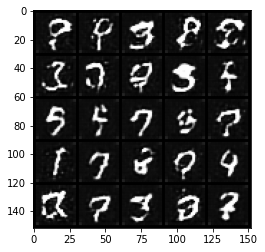

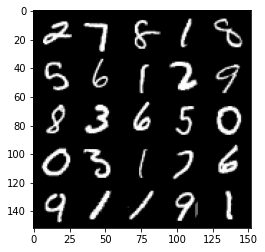

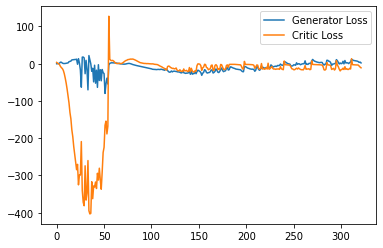

Step 6500: Generator loss: 3.181603885293007, critic loss: -14.331424467086794


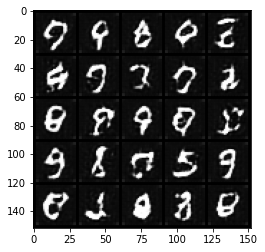

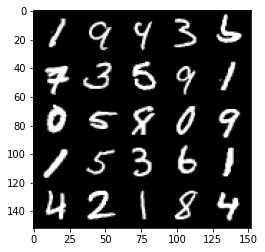

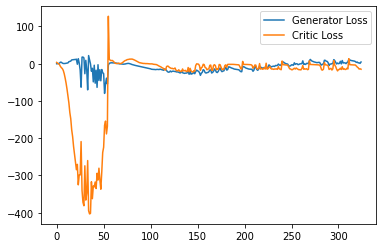

Step 6550: Generator loss: 4.8429313108325, critic loss: -12.001459001064298


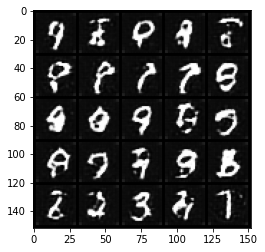

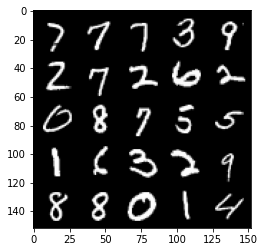

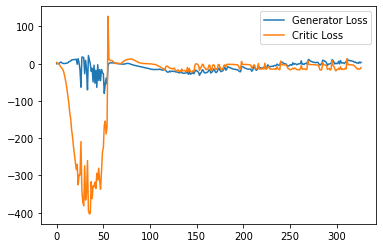

Step 6600: Generator loss: 0.47013945639133453, critic loss: -15.802399031639101


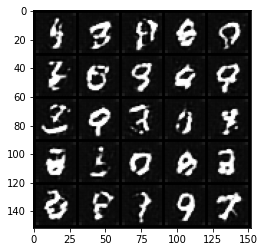

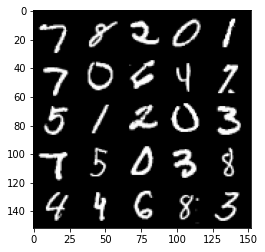

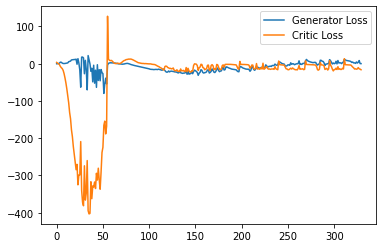

Step 6650: Generator loss: 8.374163438379764, critic loss: -9.781283230781556


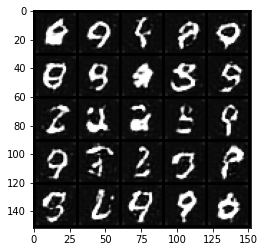

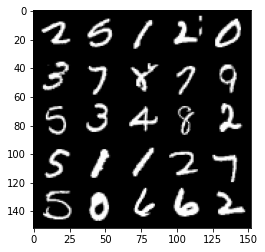

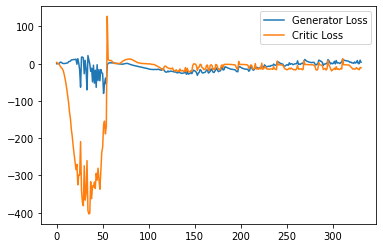

Step 6700: Generator loss: 0.6513719379901886, critic loss: -16.082645010471346


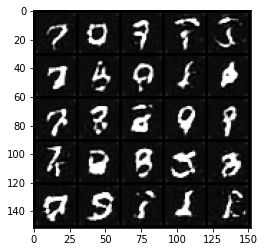

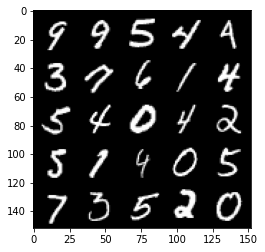

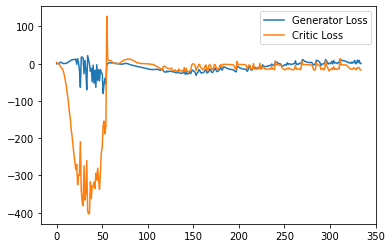

Step 6750: Generator loss: 4.512631243467331, critic loss: -15.148167375564574


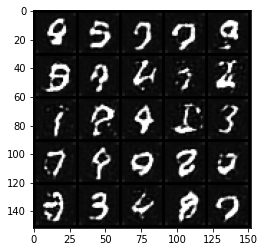

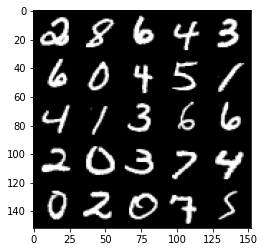

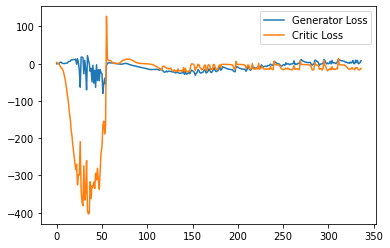

Step 6800: Generator loss: 6.2970168389379975, critic loss: -10.570409831047058


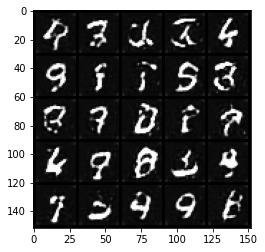

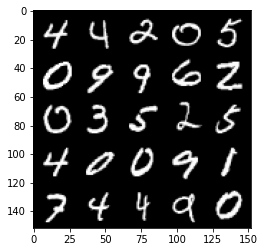

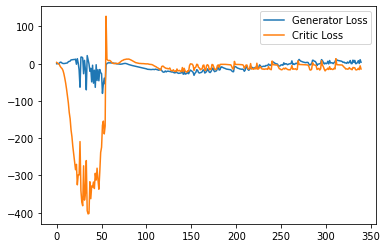

Step 6850: Generator loss: 7.443178724050522, critic loss: -3.476106341838838


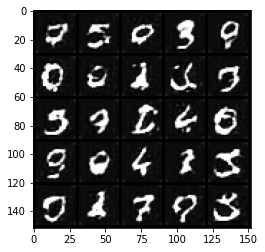

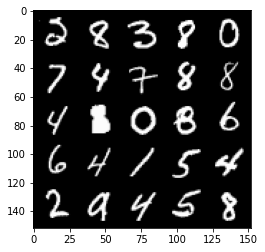

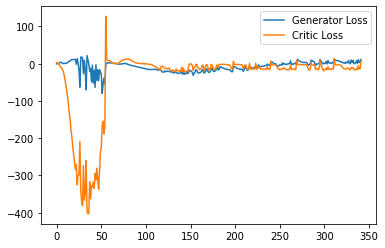

Step 6900: Generator loss: 6.886685743629933, critic loss: -7.801229917049406


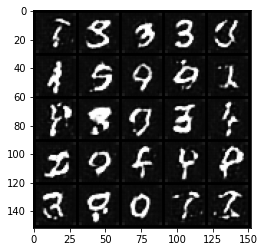

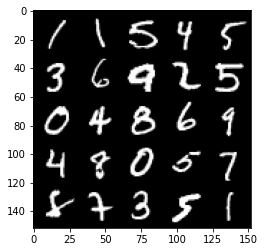

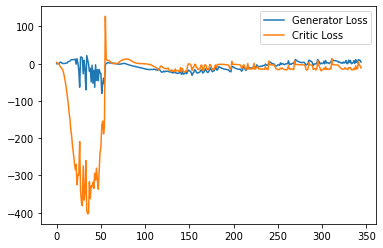

Step 6950: Generator loss: 3.2021228206157684, critic loss: -13.645015272617341


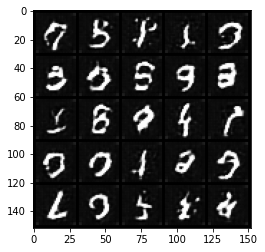

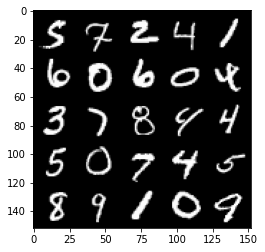

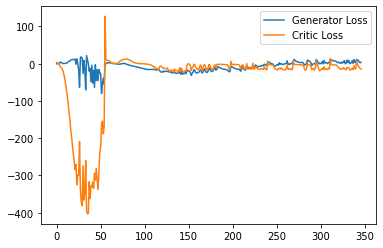

Step 7000: Generator loss: 7.365556860566139, critic loss: -12.20990667581558


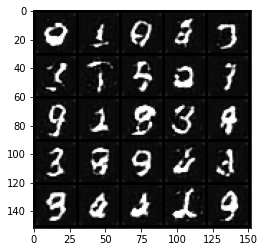

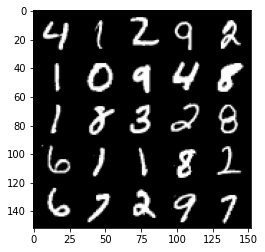

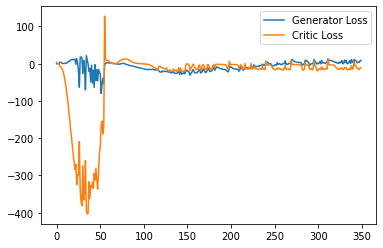

Step 7050: Generator loss: 8.224386888742448, critic loss: -11.769806188583377


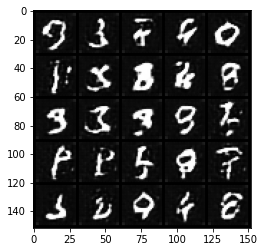

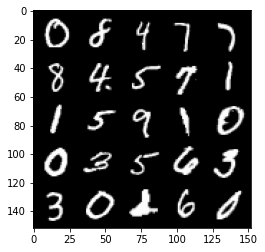

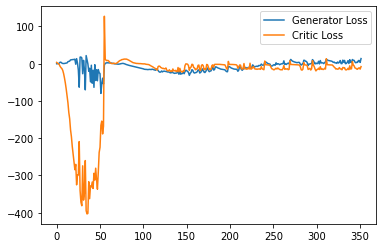

Step 7100: Generator loss: 5.998572684526444, critic loss: -12.750491002798078


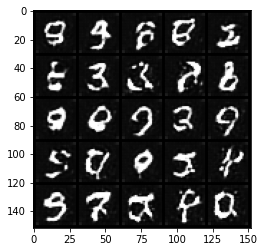

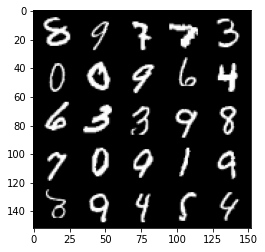

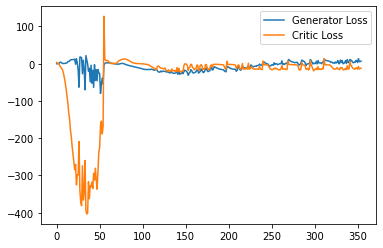

Step 7150: Generator loss: 6.624911552667617, critic loss: -12.526224010467526


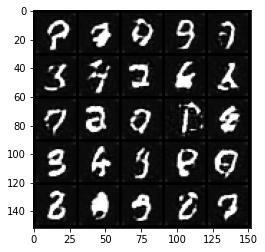

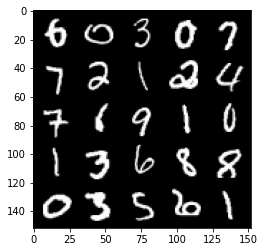

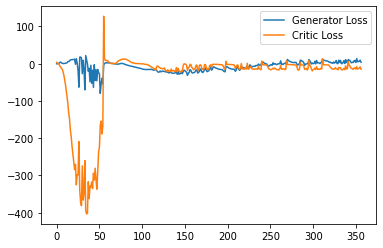

Step 7200: Generator loss: 6.61344060242176, critic loss: -16.772773083209994


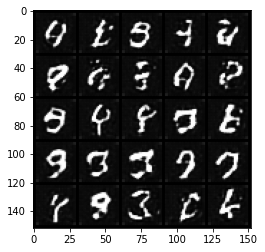

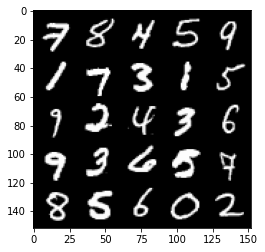

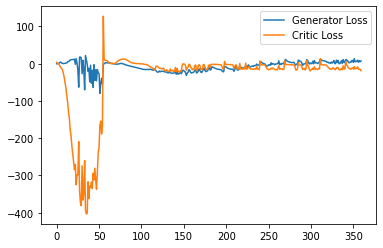

Step 7250: Generator loss: 7.095078728944063, critic loss: -14.880564769268032


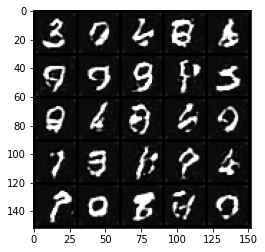

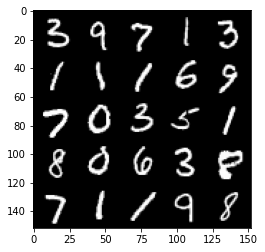

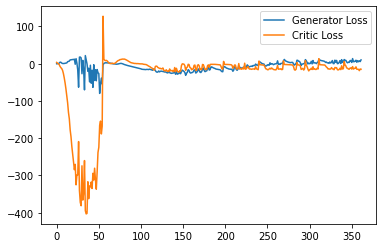

Step 7300: Generator loss: 11.804769014120103, critic loss: -0.7823147602081293


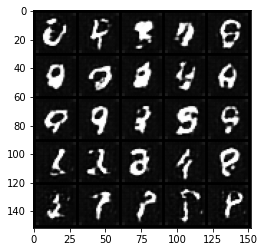

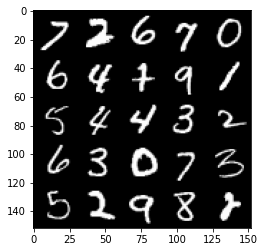

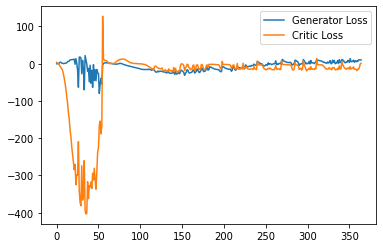

Step 7350: Generator loss: 12.597562217712403, critic loss: -3.9498429780006403


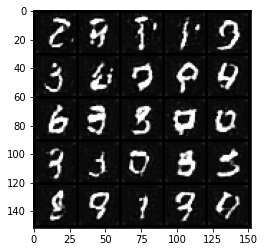

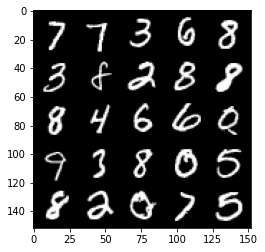

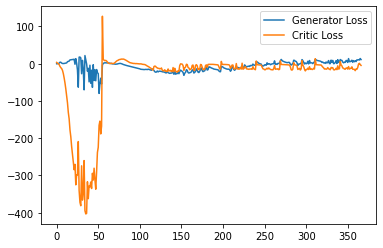

Step 7400: Generator loss: 10.522435131072998, critic loss: -9.018742046356202


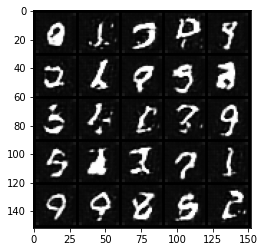

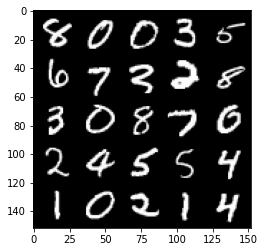

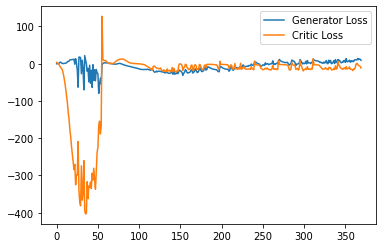

Step 7450: Generator loss: 9.617783851623535, critic loss: -12.044146838188174


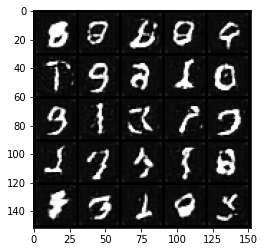

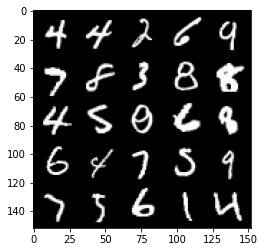

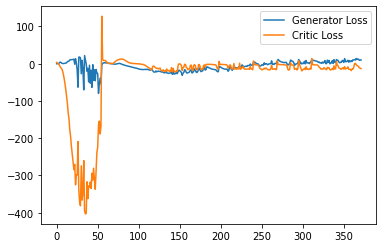

Step 7500: Generator loss: 8.13209369406104, critic loss: -13.2712920050621


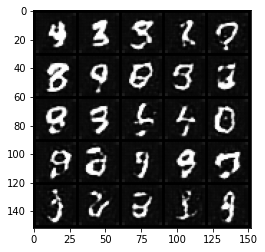

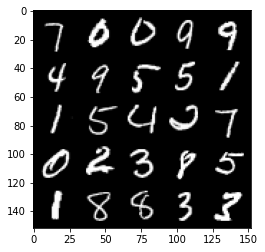

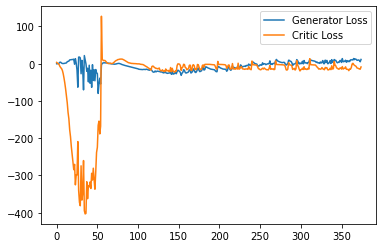

Step 7550: Generator loss: 6.5696183079481125, critic loss: -14.86490330219269


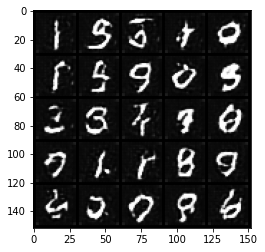

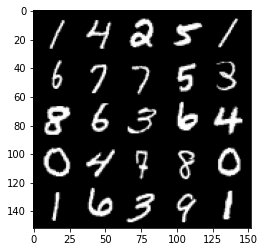

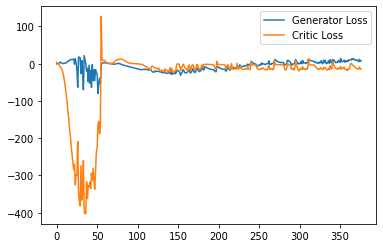

Step 7600: Generator loss: 6.445017633736134, critic loss: -17.109828194141386


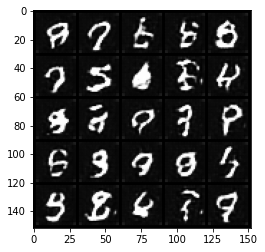

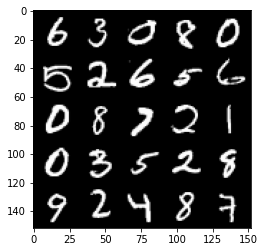

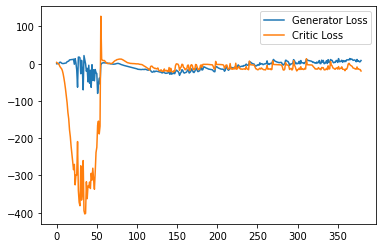

Step 7650: Generator loss: 9.439846173822879, critic loss: -11.71664896583557


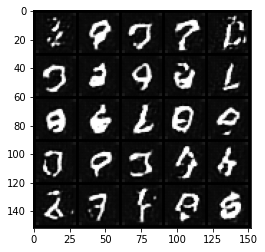

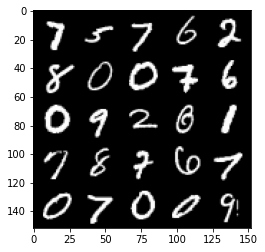

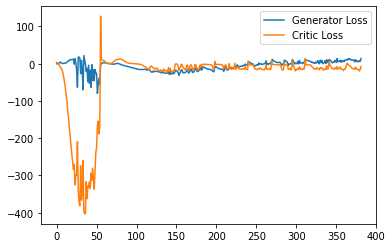

Step 7700: Generator loss: 9.6439074203372, critic loss: -13.623523744583126


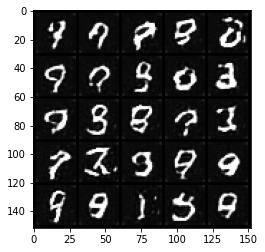

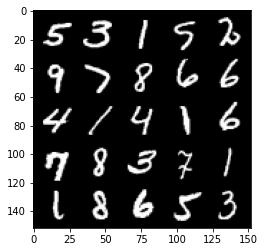

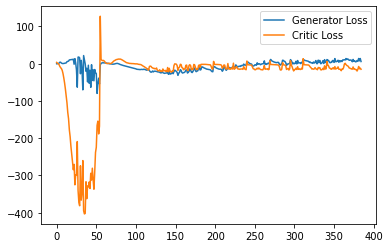

Step 7750: Generator loss: 15.735076506137847, critic loss: -5.350626937866211


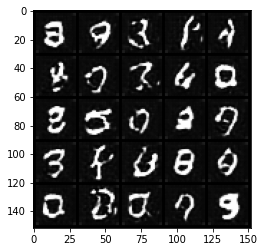

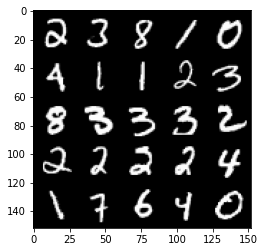

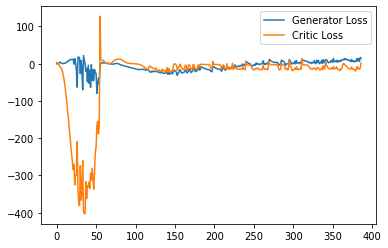

Step 7800: Generator loss: 10.70671862617135, critic loss: -14.01832600975036


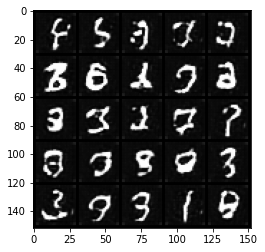

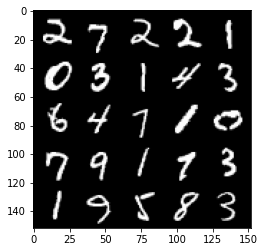

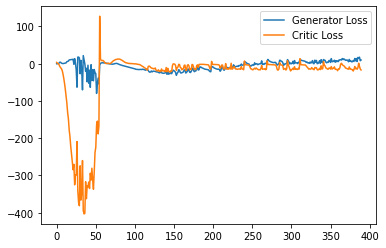

Step 7850: Generator loss: 9.894860540628434, critic loss: -14.00165397977829


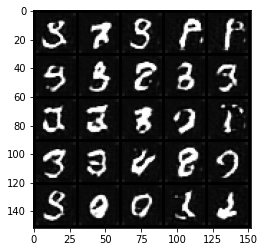

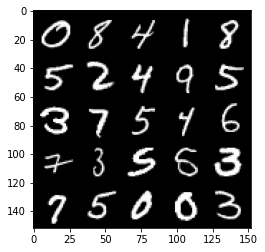

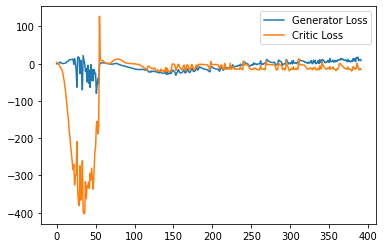

Step 7900: Generator loss: 9.696758961379528, critic loss: -14.096397478580478


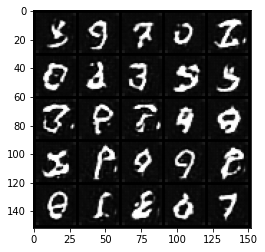

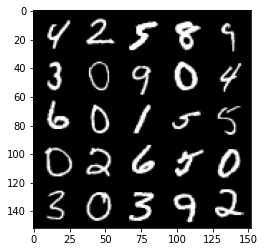

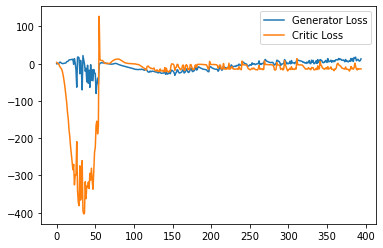

Step 7950: Generator loss: 10.221133642196655, critic loss: -13.88278376817703


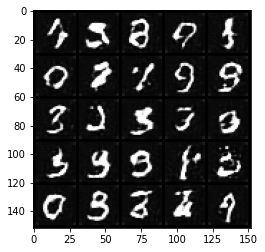

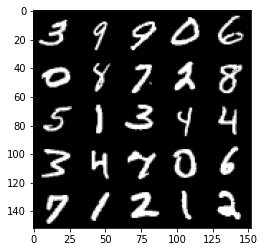

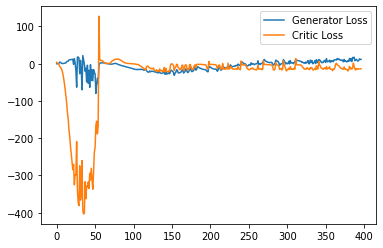

Step 8000: Generator loss: 10.294298679828644, critic loss: -15.369109127998353


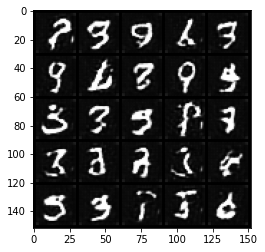

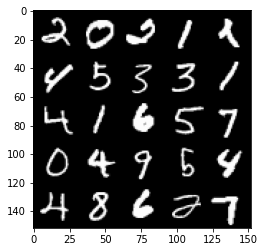

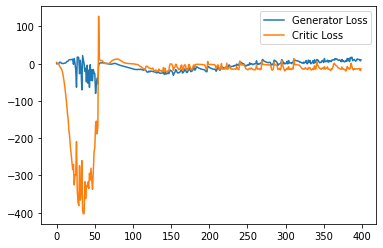

Step 8050: Generator loss: 15.198111362457276, critic loss: 0.49347890281677187


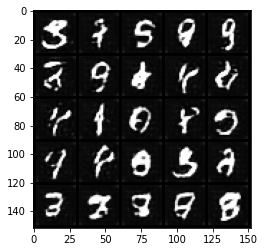

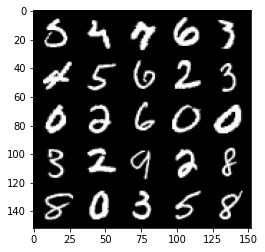

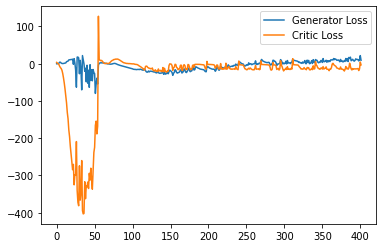

Step 8100: Generator loss: 14.238335876464843, critic loss: -0.8340170197486877


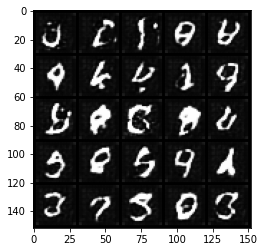

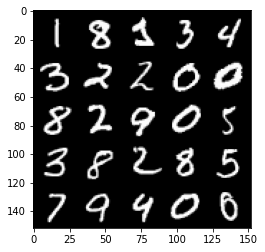

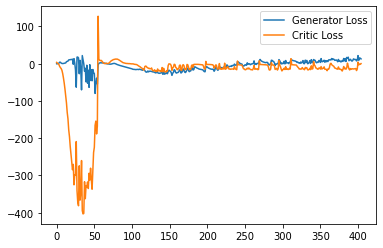

Step 8150: Generator loss: 11.72074137687683, critic loss: -4.293533681869507


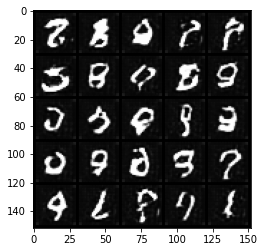

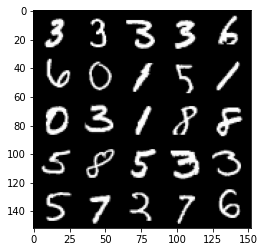

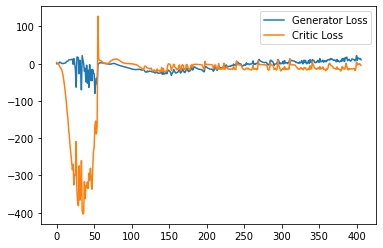

Step 8200: Generator loss: 13.655102739334106, critic loss: -8.497353137969974


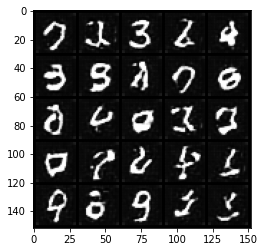

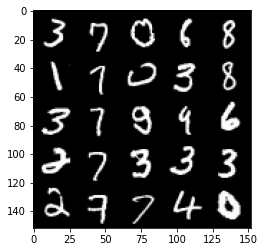

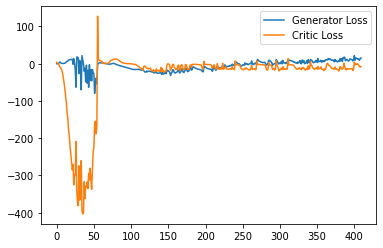

Step 8250: Generator loss: 12.524038820266723, critic loss: -11.511529119968419


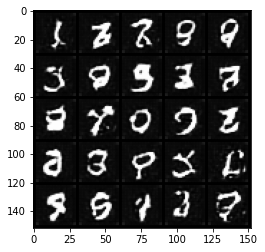

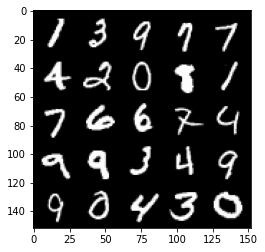

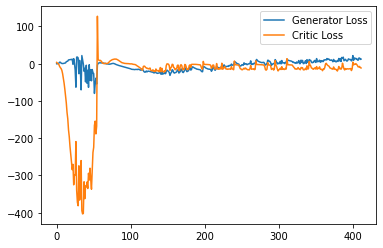

Step 8300: Generator loss: 16.053712315559387, critic loss: -9.86374840927124


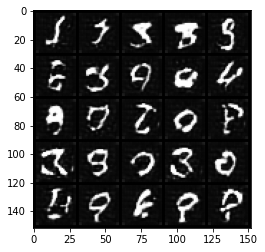

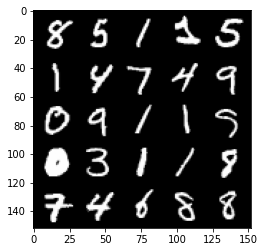

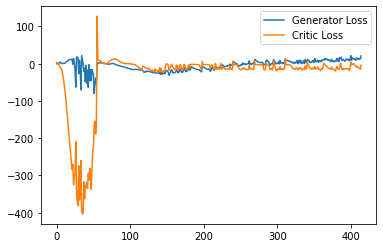

Step 8350: Generator loss: 16.31733968257904, critic loss: -9.455042559623719


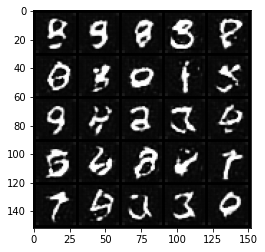

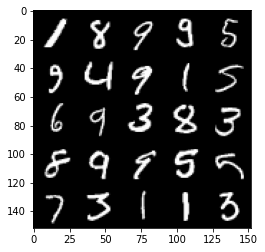

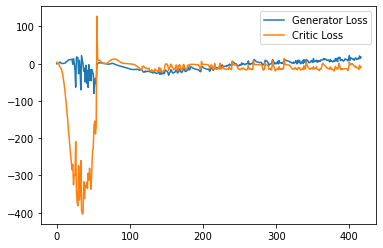

Step 8400: Generator loss: 15.667422684431076, critic loss: -8.524157091617585


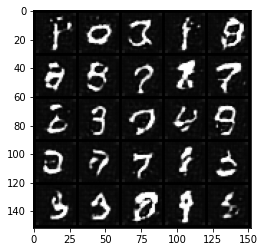

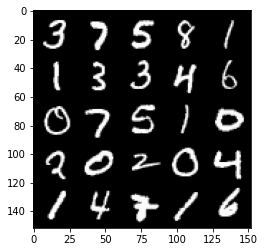

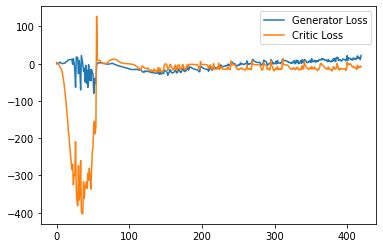

Step 8450: Generator loss: 16.977555027008055, critic loss: -6.683007555961608


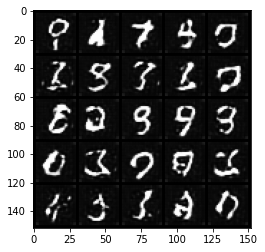

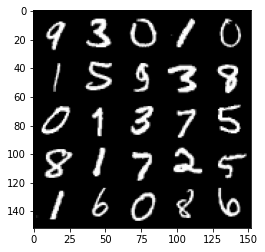

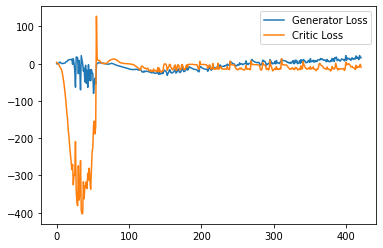

Step 8500: Generator loss: 16.993227558135985, critic loss: -8.57930966258049


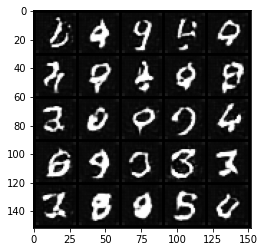

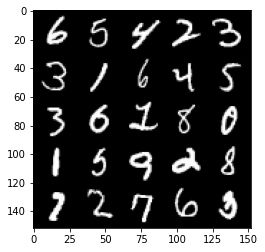

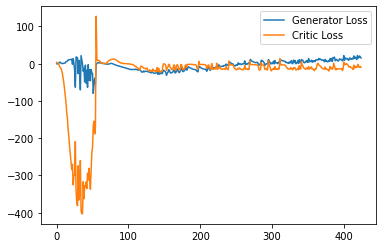

Step 8550: Generator loss: 14.765799870491028, critic loss: -12.814254528045655


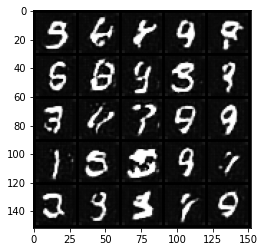

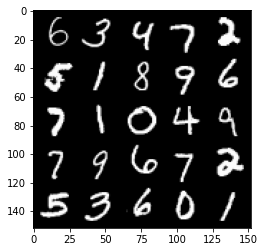

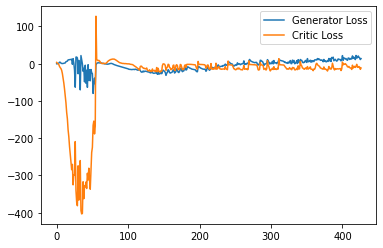

Step 8600: Generator loss: 17.114328937530516, critic loss: -10.766418916702273


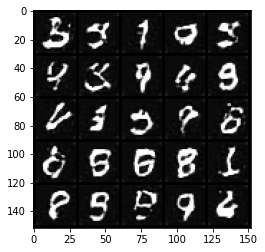

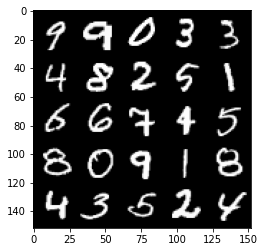

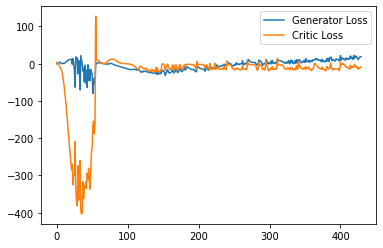

Step 8650: Generator loss: 16.330347270965575, critic loss: -11.025233142375944


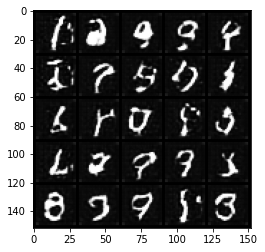

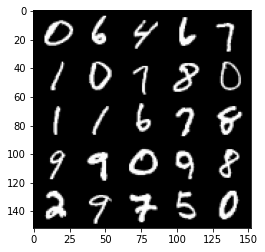

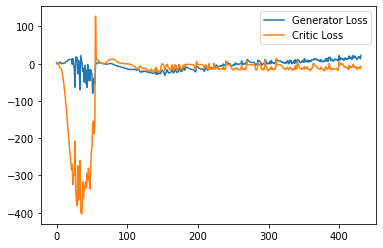

Step 8700: Generator loss: 18.43273443222046, critic loss: -10.788984534263612


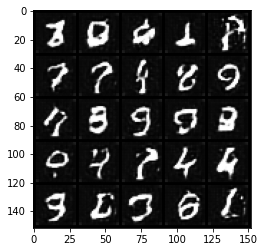

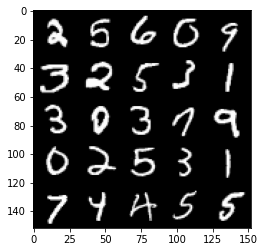

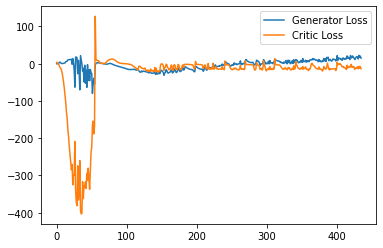

Step 8750: Generator loss: 13.117417612075805, critic loss: -14.312162198543549


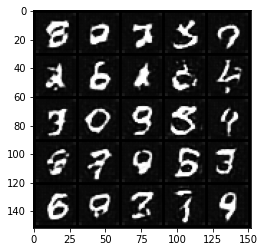

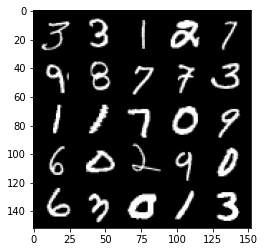

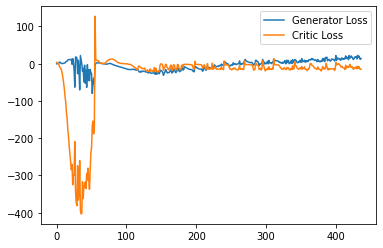

Step 8800: Generator loss: 16.355498991012574, critic loss: -14.657553626060489


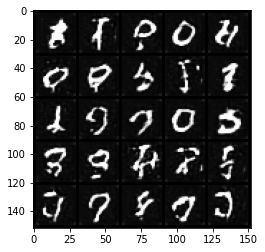

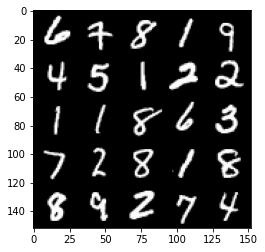

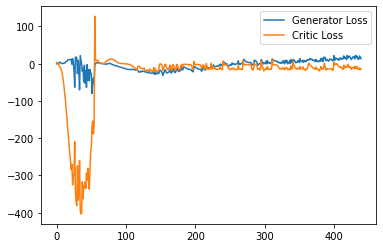

Step 8850: Generator loss: 18.828547706604002, critic loss: -12.346745851993562


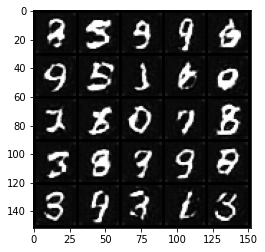

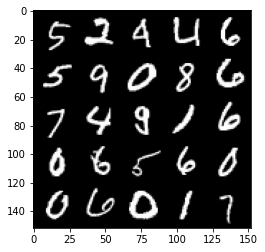

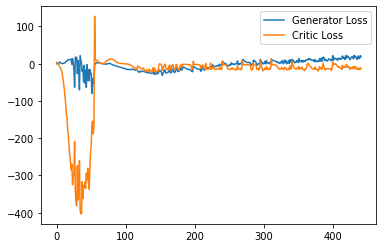

Step 8900: Generator loss: 18.331354403495787, critic loss: -12.269860209941863


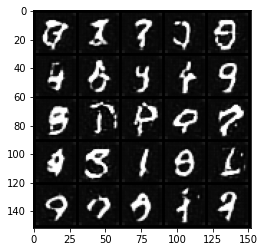

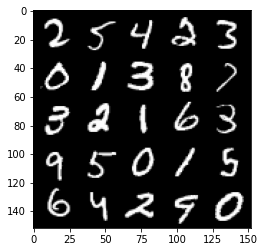

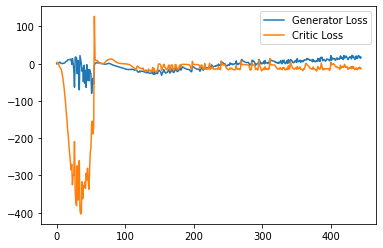

Step 8950: Generator loss: 16.65578936100006, critic loss: -13.187829045534137


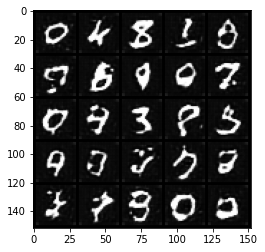

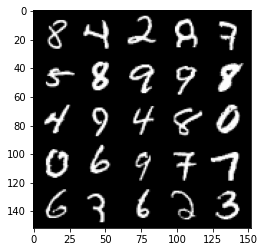

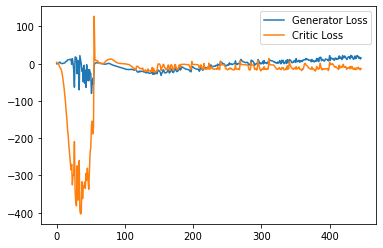

Step 9000: Generator loss: 14.12423160582781, critic loss: -8.512659080028534


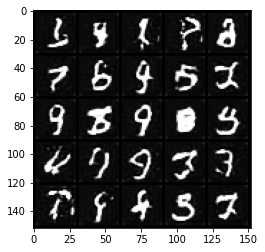

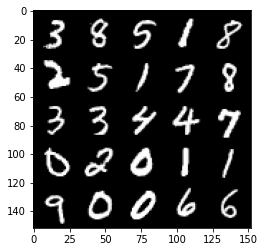

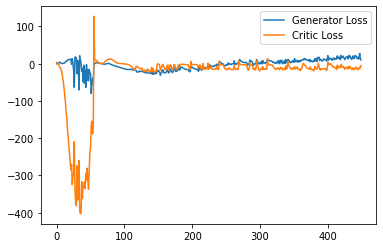

Step 9050: Generator loss: 16.388381910324096, critic loss: -14.282306030273435


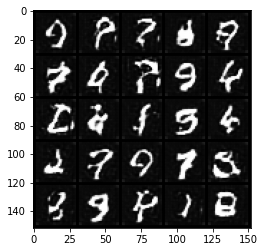

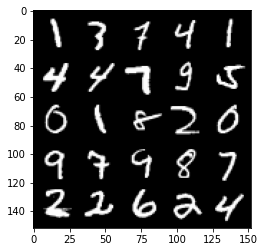

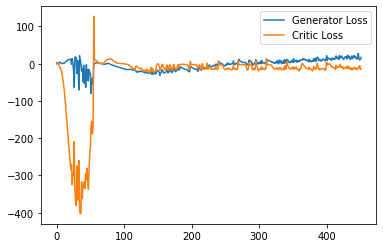

Step 9100: Generator loss: 16.355091283321382, critic loss: -13.274104044437408


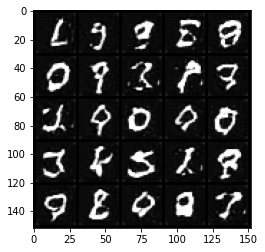

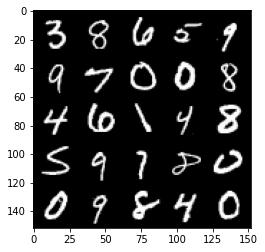

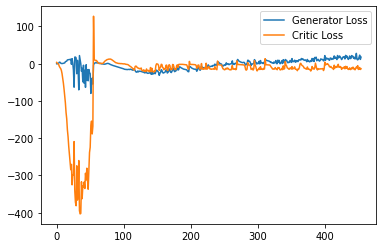

Step 9150: Generator loss: 21.393778853416443, critic loss: -10.326941973924638


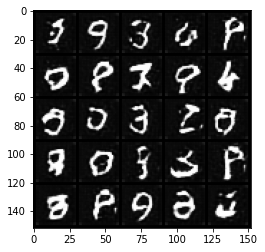

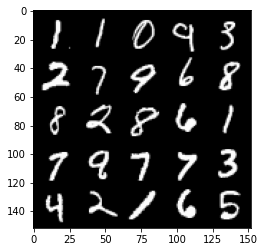

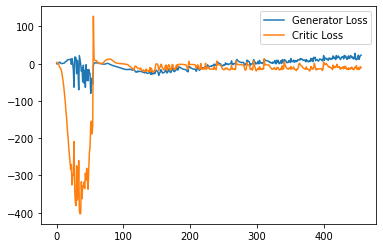

Step 9200: Generator loss: 19.400861320495604, critic loss: -13.4753737373352


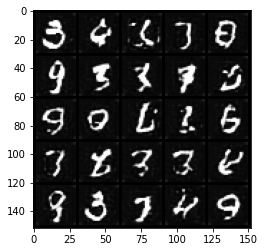

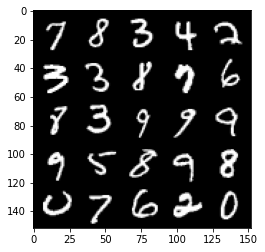

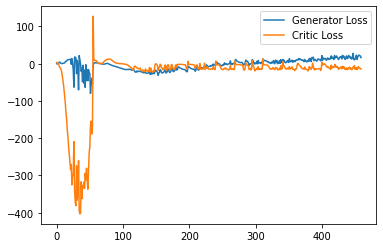

Step 9250: Generator loss: 23.071228771209718, critic loss: -9.589762923240663


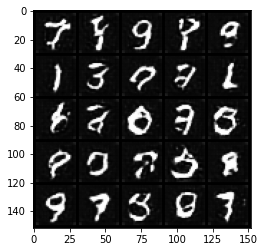

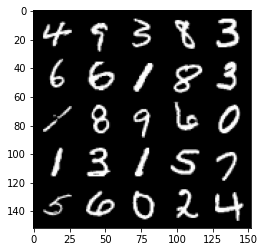

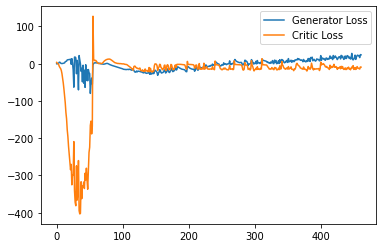

Step 9300: Generator loss: 18.331721687316893, critic loss: -14.185619113922117


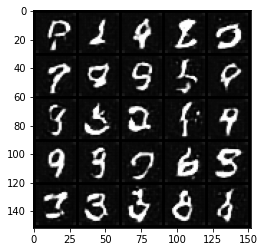

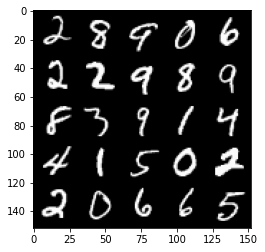

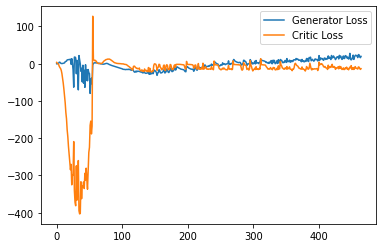

Step 9350: Generator loss: 19.130428266525268, critic loss: -12.41358849811554


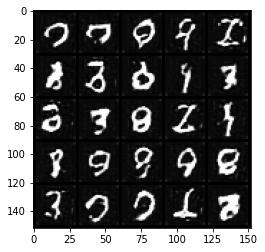

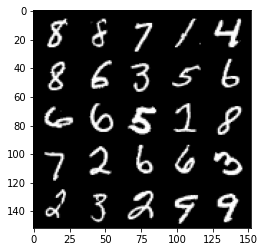

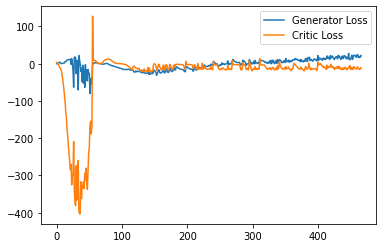

Step 9400: Generator loss: 18.987493953704835, critic loss: -14.500716795921328


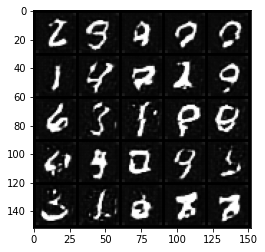

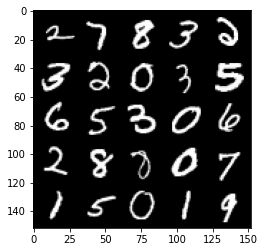

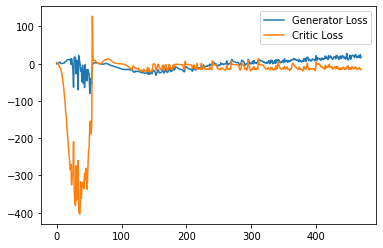

Step 9450: Generator loss: 22.464070434570313, critic loss: -14.020395532608031


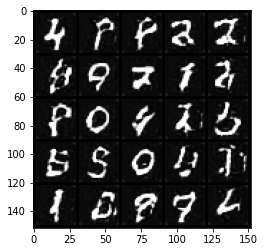

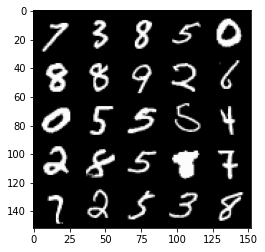

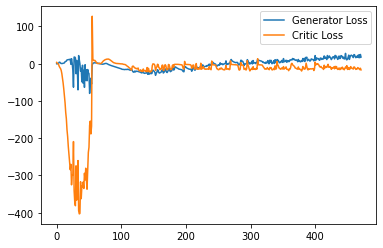

Step 9500: Generator loss: 15.560979356765747, critic loss: -13.297605815887447


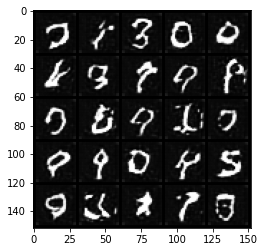

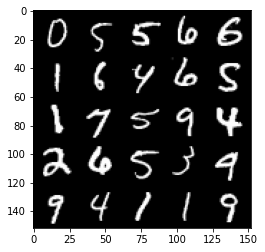

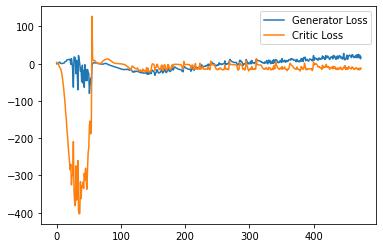

Step 9550: Generator loss: 18.640513849258422, critic loss: -10.830256858348841


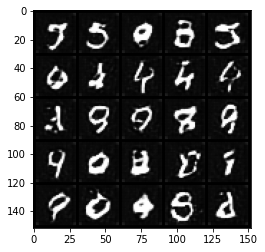

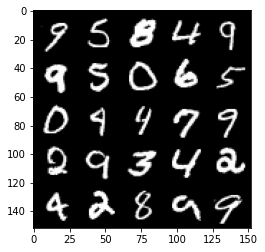

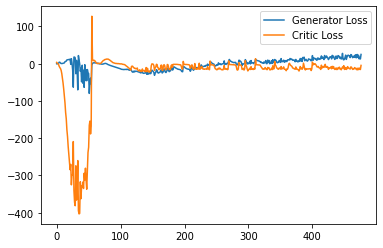

Step 9600: Generator loss: 20.84914532661438, critic loss: -12.27852238273621


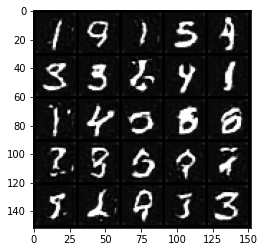

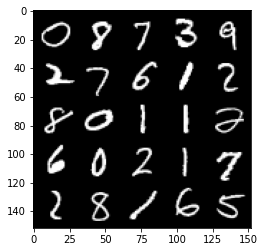

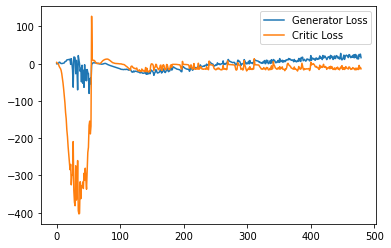

Step 9650: Generator loss: 16.689141187667847, critic loss: -12.878416823387148


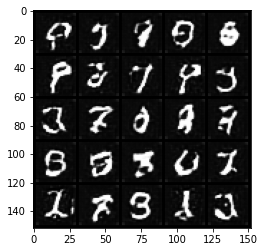

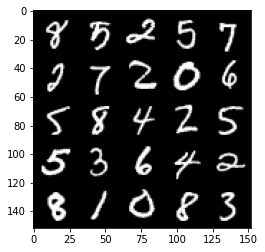

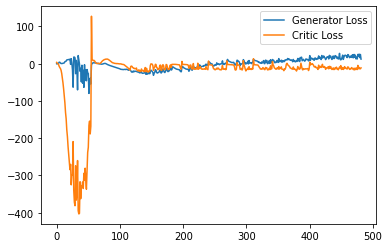

Step 9700: Generator loss: 20.918622426986694, critic loss: -5.412127182483674


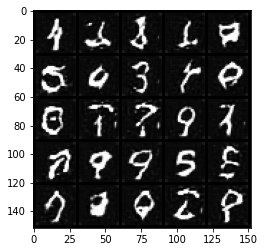

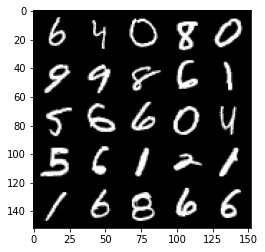

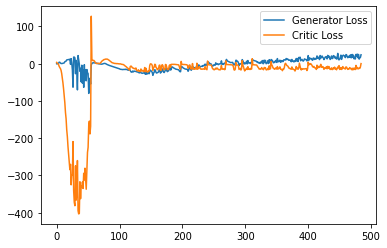

Step 9750: Generator loss: 19.64925108909607, critic loss: -9.16321696805954


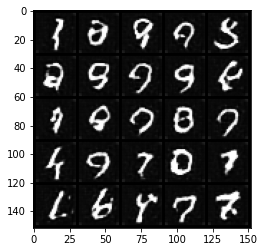

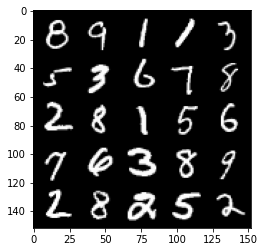

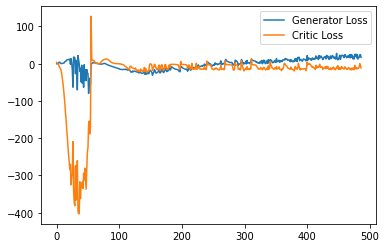

Step 9800: Generator loss: 21.25612533569336, critic loss: -10.282986547470093


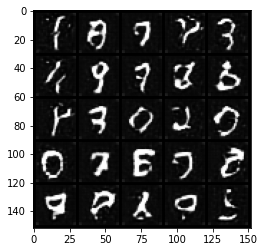

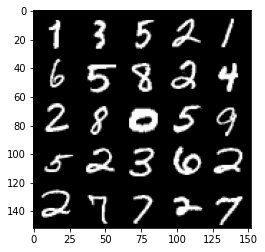

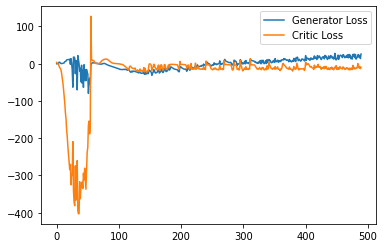

Step 9850: Generator loss: 19.227067670822144, critic loss: -10.85316471529007


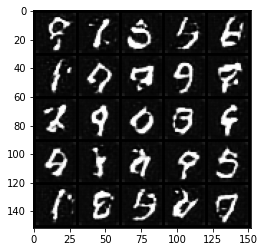

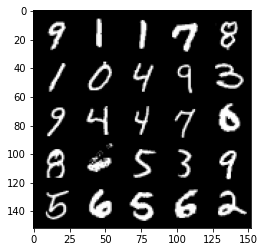

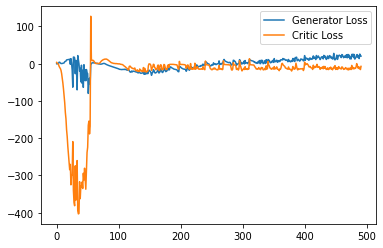

Step 9900: Generator loss: 19.91563430786133, critic loss: -11.484123400688173


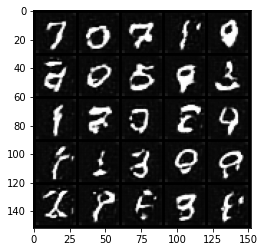

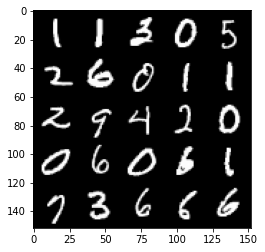

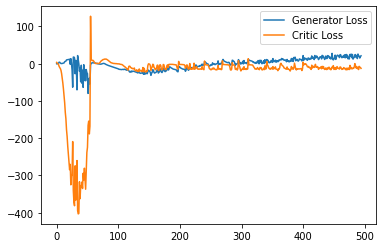

Step 9950: Generator loss: 18.941342306137084, critic loss: -9.728389787673947


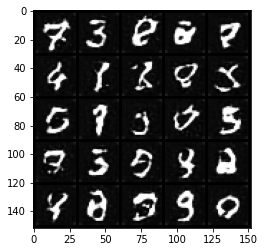

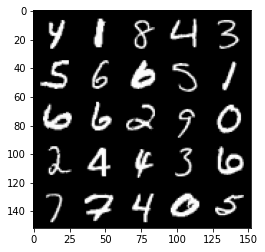

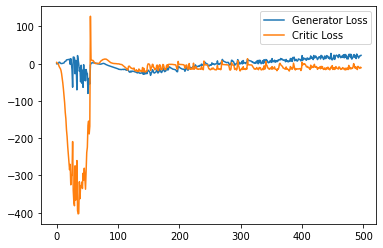

Step 10000: Generator loss: 15.495938453674317, critic loss: -13.971944056749344


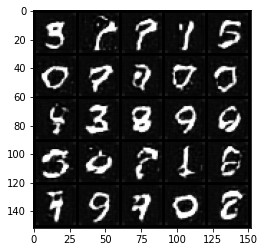

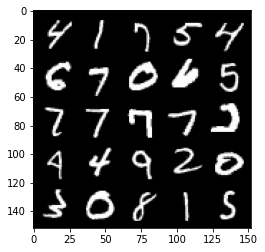

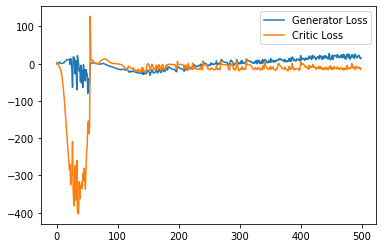

Step 10050: Generator loss: 18.366252908706667, critic loss: -11.934645759582517


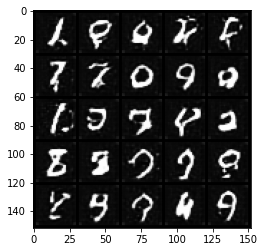

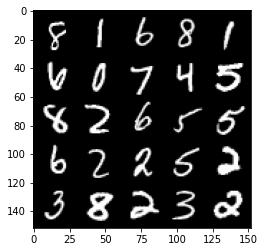

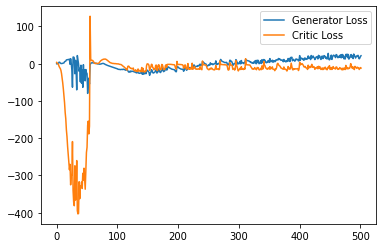

Step 10100: Generator loss: 15.237388224601746, critic loss: -9.644251254081723


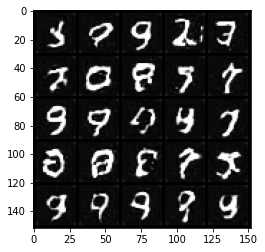

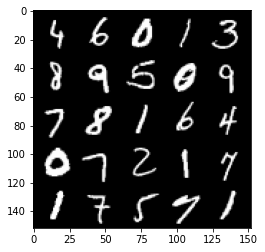

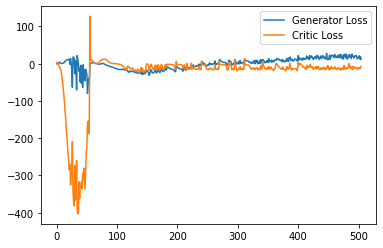

Step 10150: Generator loss: 12.131927924156189, critic loss: -14.277635872840888


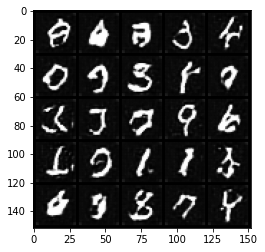

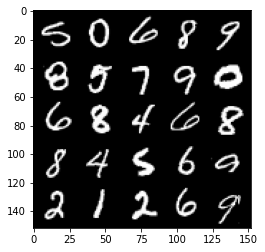

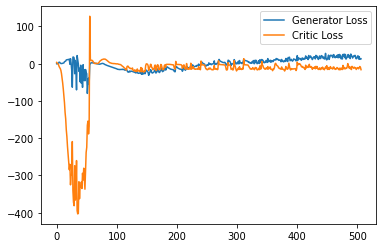

Step 10200: Generator loss: 18.10996149480343, critic loss: -11.148822519063948


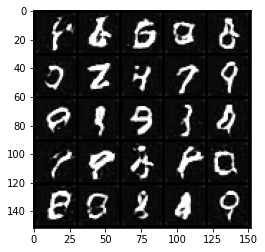

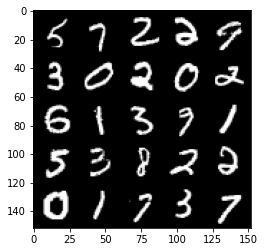

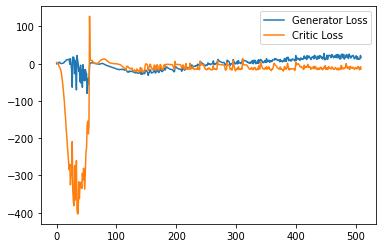

Step 10250: Generator loss: 17.12027316570282, critic loss: -13.538640940189365


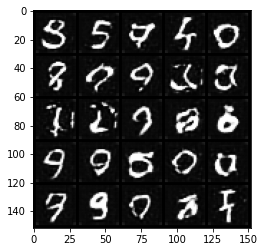

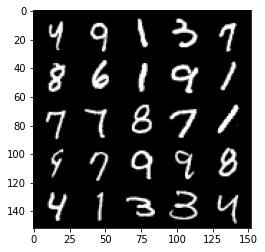

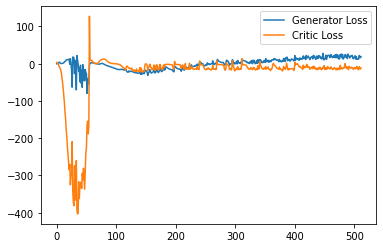

Step 10300: Generator loss: 18.53353010892868, critic loss: -10.976896745681762


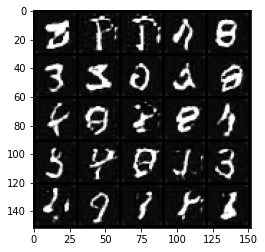

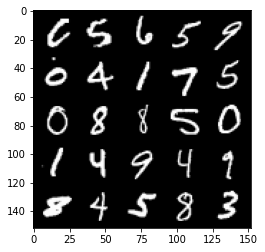

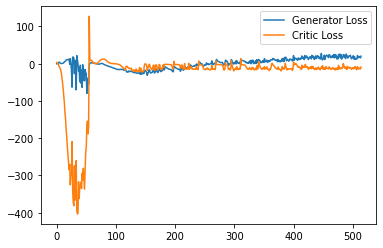

Step 10350: Generator loss: 16.28359062075615, critic loss: -13.198156092166903


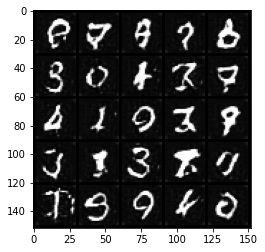

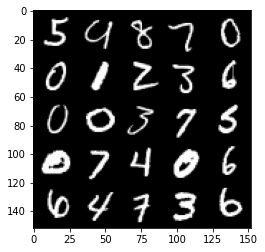

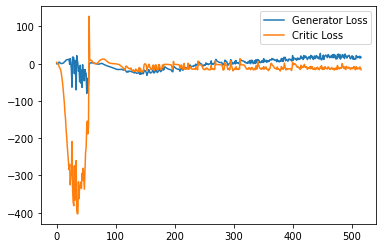

Step 10400: Generator loss: 15.370084595680236, critic loss: -13.478828421592711


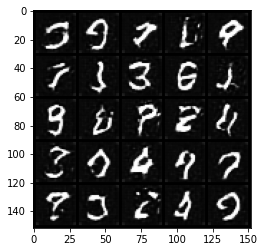

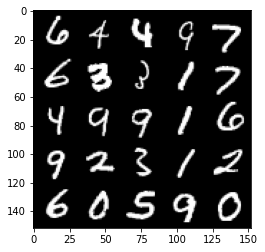

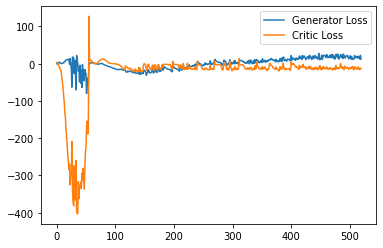

Step 10450: Generator loss: 17.491300152540205, critic loss: -15.005015613555909


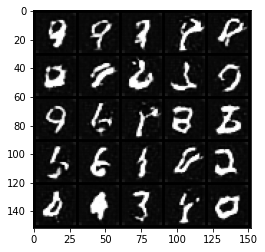

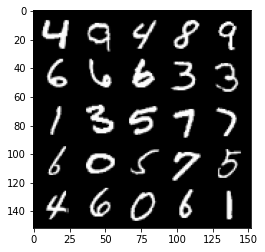

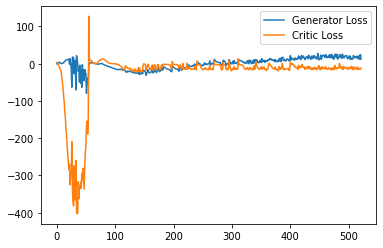

Step 10500: Generator loss: 16.57231303811073, critic loss: -14.672802391290661


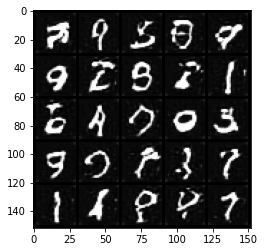

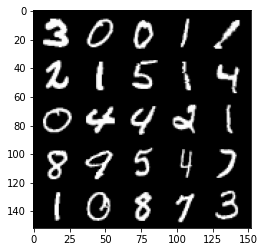

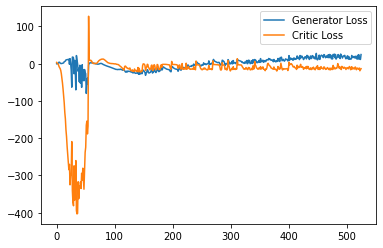

Step 10550: Generator loss: 17.51472911775112, critic loss: -9.4280433883667


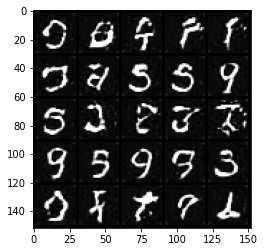

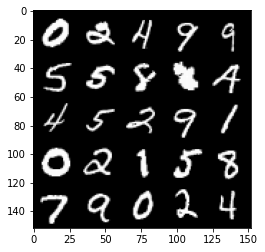

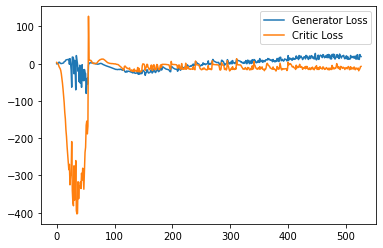

Step 10600: Generator loss: 16.96352057784796, critic loss: -11.841812671899797


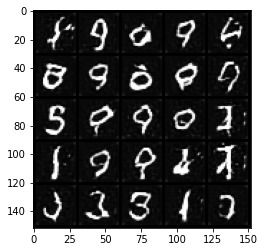

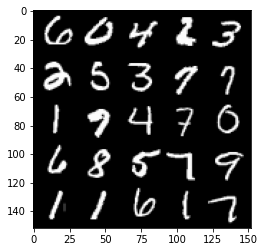

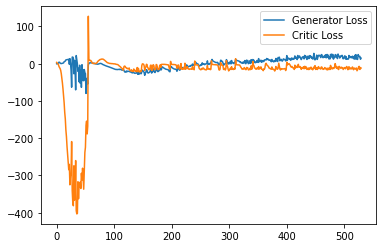

Step 10650: Generator loss: 17.33204164981842, critic loss: -12.525078016519544


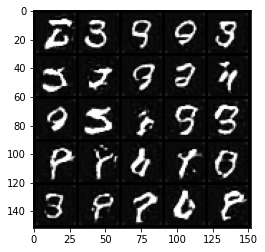

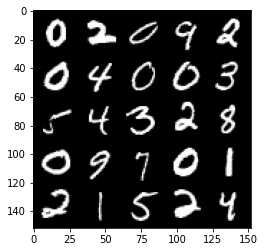

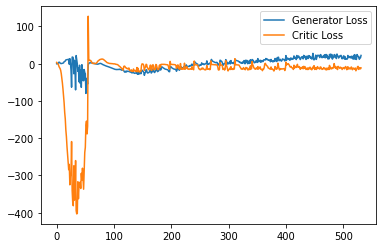

Step 10700: Generator loss: 15.93243319272995, critic loss: -12.603900796890256


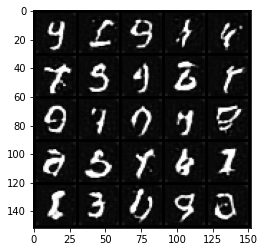

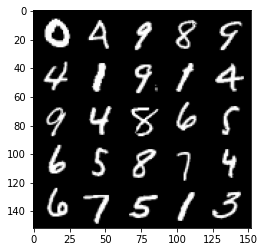

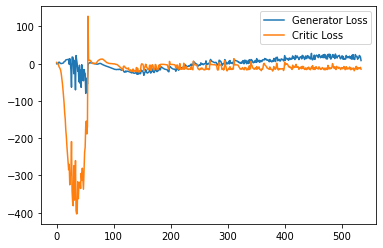

Step 10750: Generator loss: 20.31398053228855, critic loss: -11.931871636390685


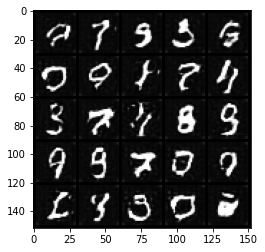

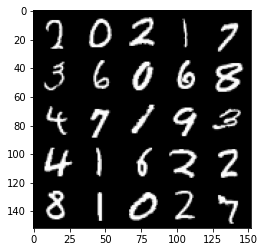

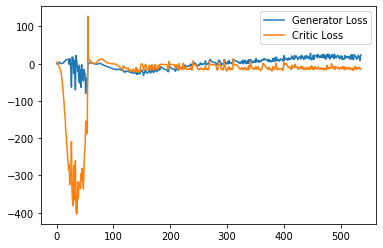

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            # Update critic
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)


            mean_iteration_critic_loss += crit_loss.item() / crit_repeats

            crit_loss.backward(retain_graph=True)
            crit_opt.step()

        critic_losses += [mean_iteration_critic_loss]

        # Update generator
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        gen_opt.step()

        generator_losses += [gen_loss.item()]

        # Visualization
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1